## Exploratory Data Analysis
FNID Dataset: Fake News Inference Dataset - Part 1

In [1]:
import pandas as pd
import numpy as np
from scipy import stats
import pickle
import re
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
from scipy.stats import zscore
import plotly.express as px 
import plotly.graph_objects as go
sns.set()
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

#### Load Data

In [2]:
# load fnid dataset
fnid = pd.read_csv('fakenn.csv')

print(fnid.shape)
fnid.head()

(17326, 8)


,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake


In [223]:
fnid.loc[5, :]

id                                                                      5073
date                                               2012-01-06T13:29:58-05:00
speaker                                                         Barack Obama
statement                  President Barack Obama "put in place historic ...
sources                    ['http://www.youtube.com/watch?v=f86IferxohM&f...
paragraph_based_content    ['With all eyes on Iowa for the Republican cau...
fullText_based_content     With all eyes on Iowa for the Republican caucu...
label_fnn                                                               real
date2                                                    2012-01-06 00:00:00
year                                                                    2012
num_words                                                                833
source2                                                      www.youtube.com
num_chars                                                               4956

In [220]:
fnid['fullText_based_content'][5]

'With all eyes on Iowa for the Republican caucuses in the first days of 2012, the Democratic contender for president reminded watchers of his own Iowa win — and what he has done to keep his campaign promises.\nObama for America bought banner ads across the home page of the online Des Moines Register on Jan. 3, 2012, with a link to highlights from Obama\'s 2008 victory speech .\nMusic plays as candidate Barack Obama promises action on health care, taxes, energy independence and the war in Iraq. Between clips, white text across the screen highlights President Obama\'s policy accomplishments.\nFor example, after candidate Obama declares, "I\'ll be a president who harnesses the ingenuity of farmers and scientists and entrepreneurs to free this nation from the tyranny of oil once and for all!" the next three screens show an image of him driving a car and the words: "Put in place historic fuel efficiency standards for cars and trucks to lower costs at the pump and reduce dependence on foreig

In [33]:
# check null data
fnid.isnull().sum()

id                         0
date                       0
speaker                    0
statement                  0
sources                    0
paragraph_based_content    0
fullText_based_content     0
label_fnn                  0
dtype: int64

In [11]:
fnid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17326 entries, 0 to 17325
Data columns (total 8 columns):
id                         17326 non-null object
date                       17326 non-null object
speaker                    17326 non-null object
statement                  17326 non-null object
sources                    17326 non-null object
paragraph_based_content    17326 non-null object
fullText_based_content     17326 non-null object
label_fnn                  17326 non-null object
dtypes: object(8)
memory usage: 1.1+ MB


<IPython.core.display.Javascript object>


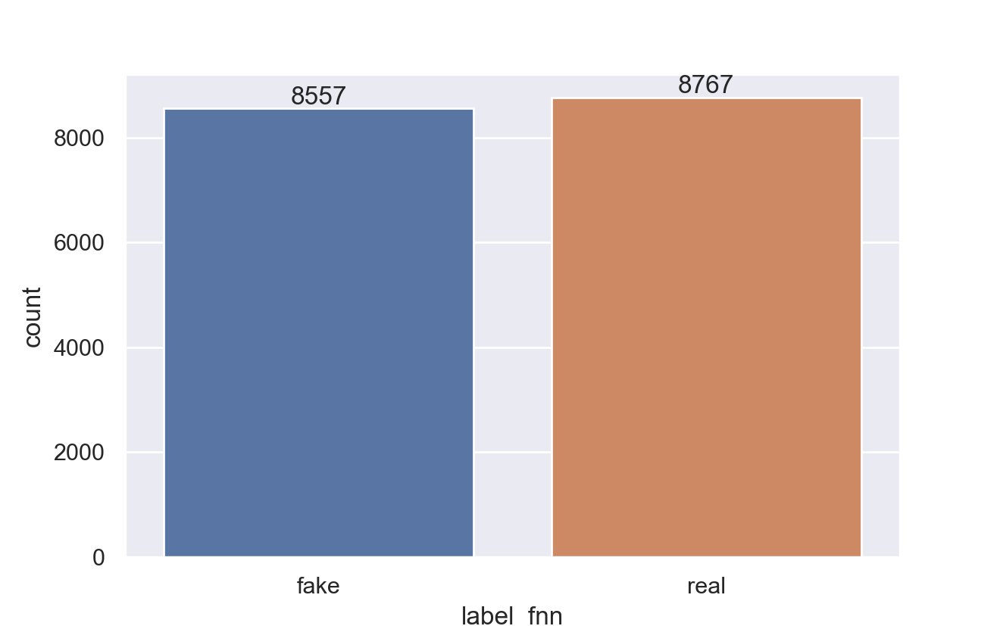

In [41]:
# balanced data
ax=sns.countplot(x="label_fnn", data=fnid)
for p in ax.patches:
    ax.annotate("%.f" % p.get_height(), xy=(p.get_x()+p.get_width()/2, p.get_height()),
            xytext=(0, 5), textcoords='offset points', ha="center", va="center");

#### Frequency/Distribution
Look at speaker, date/year - includes some data cleaning

In [6]:
# unique speakers
len(fnid['speaker'].unique())

4213

<IPython.core.display.Javascript object>


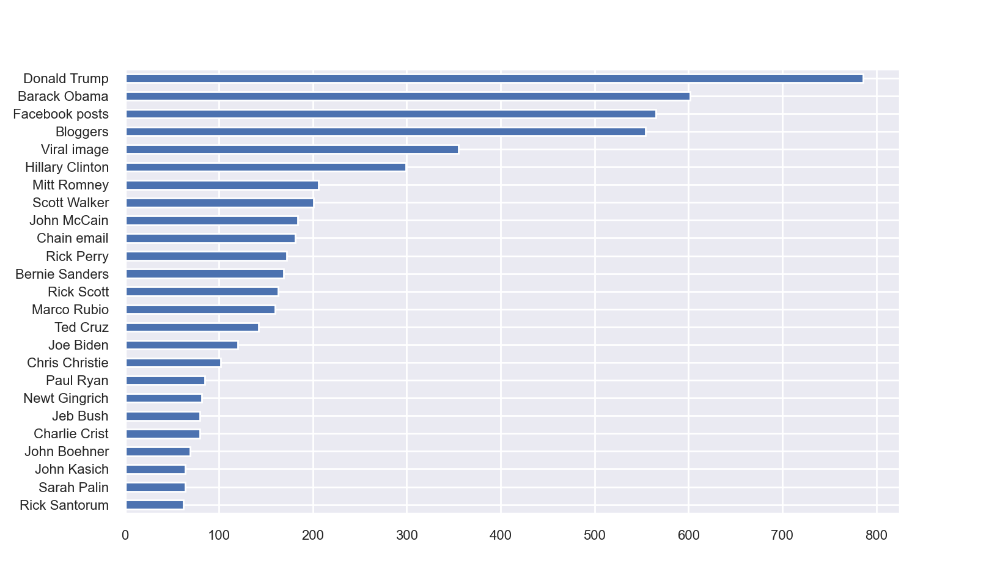

In [144]:
# top speakers
ax=fnid['speaker'].value_counts().sort_values(ascending=False).iloc[:25].plot(kind = 'barh', fontsize=8)
ax.invert_yaxis();

<IPython.core.display.Javascript object>


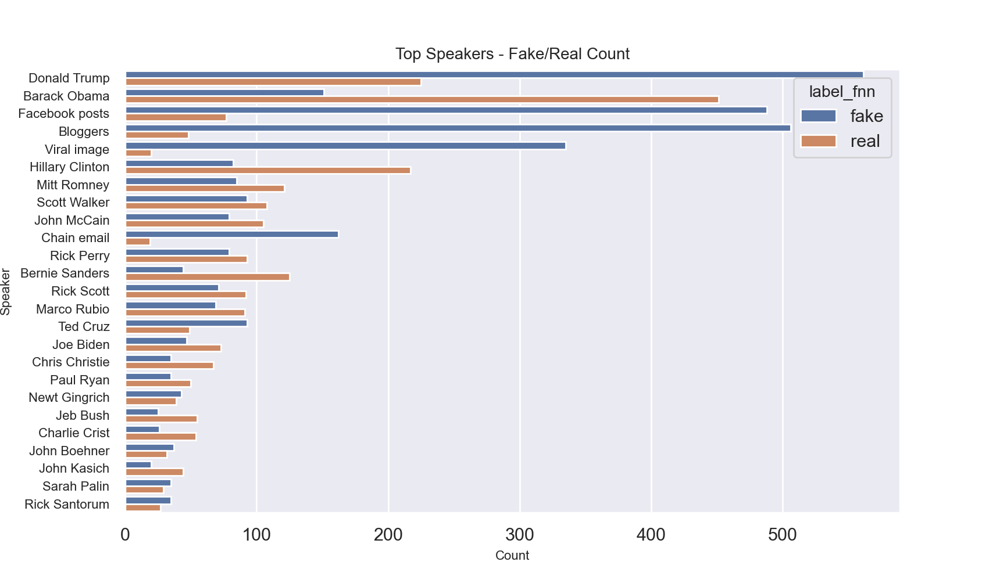

In [146]:
# top speakers - real/fake distribution
speaker_order=fnid['speaker'].value_counts().sort_values(ascending=False).iloc[:25].index
ax=sns.countplot(data=fnid, y='speaker', hue="label_fnn",
              order=speaker_order)
ax.set_title('Top Speakers - Fake/Real Count',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=8)
ax.set_ylabel('Speaker',fontsize=8);

<IPython.core.display.Javascript object>


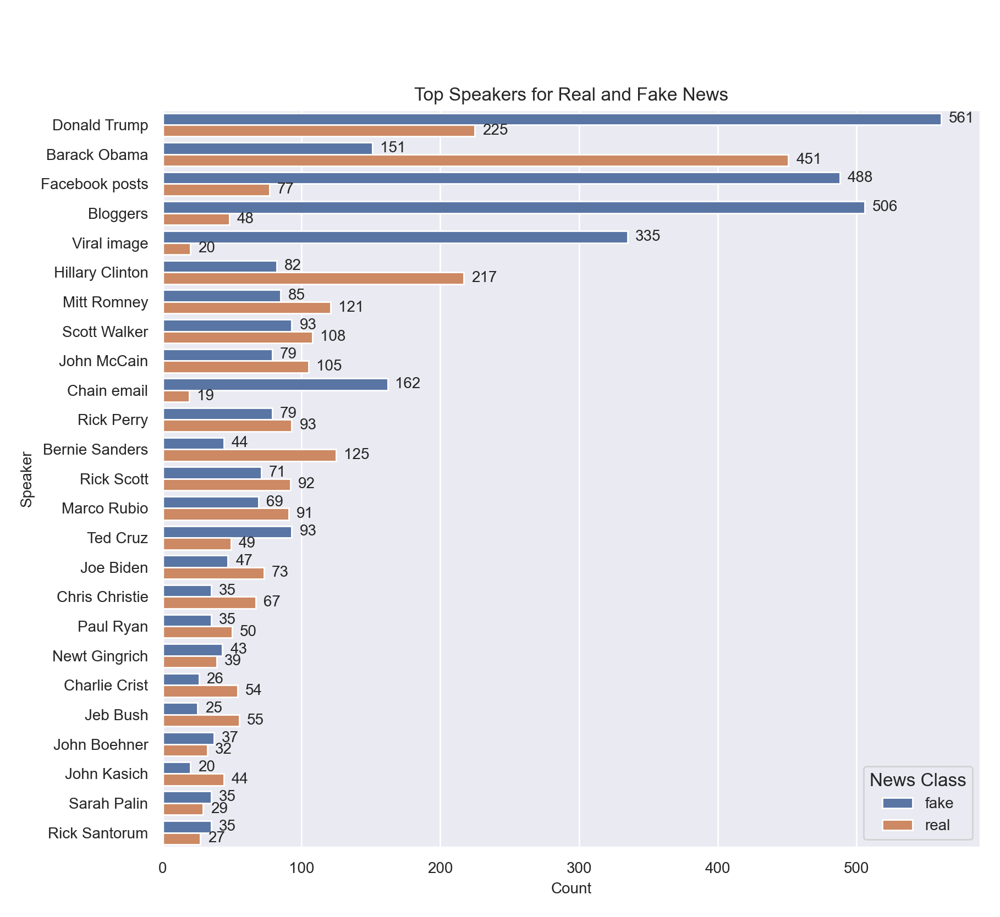

In [297]:
speaker_order=fnid['speaker'].value_counts().sort_values(ascending=False).iloc[:25].index

fig, ax = plt.subplots(1, 1, figsize=(9, 8))
sns.countplot(data=fnid, y='speaker', hue="label_fnn",
              order=speaker_order,ax=ax)

ax.set_title('Top Speakers for Real and Fake News',fontsize=12)
ax.set_xlabel('Count', fontsize=10)
ax.set_ylabel('Speaker',fontsize=10);
ax.yaxis.set_tick_params(labelsize=10)
ax.xaxis.set_tick_params(labelsize=10)

ax.legend(title='News Class', title_fontsize=12, prop=dict(size=10))

for p in ax.patches:
    ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=10)
    
fig.tight_layout()
fig.subplots_adjust(top=0.88);

<IPython.core.display.Javascript object>


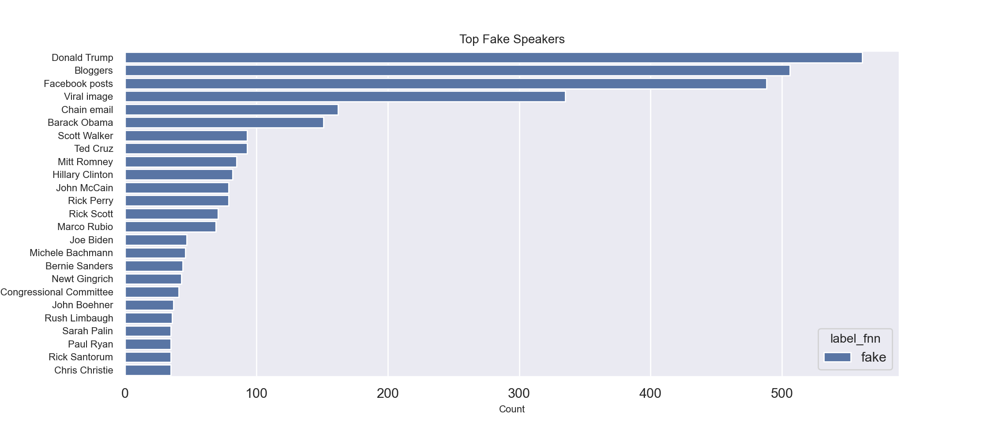

In [147]:
# top fake news speakers
ax=sns.countplot(data=fnid[fnid['label_fnn']=='fake'], y='speaker', hue="label_fnn",
              order=fnid[fnid['label_fnn']=='fake']['speaker'].value_counts().sort_values(ascending=False).iloc[:25].index)
ax.set_title('Top Fake Speakers',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=8)
ax.set_ylabel('Speaker',fontsize=8);

In [8]:
# unique sources
len(fnid['sources'].unique())

16913

In [3]:
# adjust date 
fnid['date2'] = pd.to_datetime(fnid['date'].str.split('T',expand=True)[0], errors='coerce')

In [4]:
# get article year
fnid['year'] = pd.to_datetime(fnid['date'].str.split('T',expand=True)[0], 
                              errors='coerce').dt.year

In [5]:
# drop data with no year information
fnid.drop(fnid[fnid['year'].isnull()].index, inplace = True)
fnid[fnid['year'].isnull()].index

Int64Index([], dtype='int64')

In [6]:
# convert year to integer
fnid['year'] = fnid['year'].astype(int)

<IPython.core.display.Javascript object>


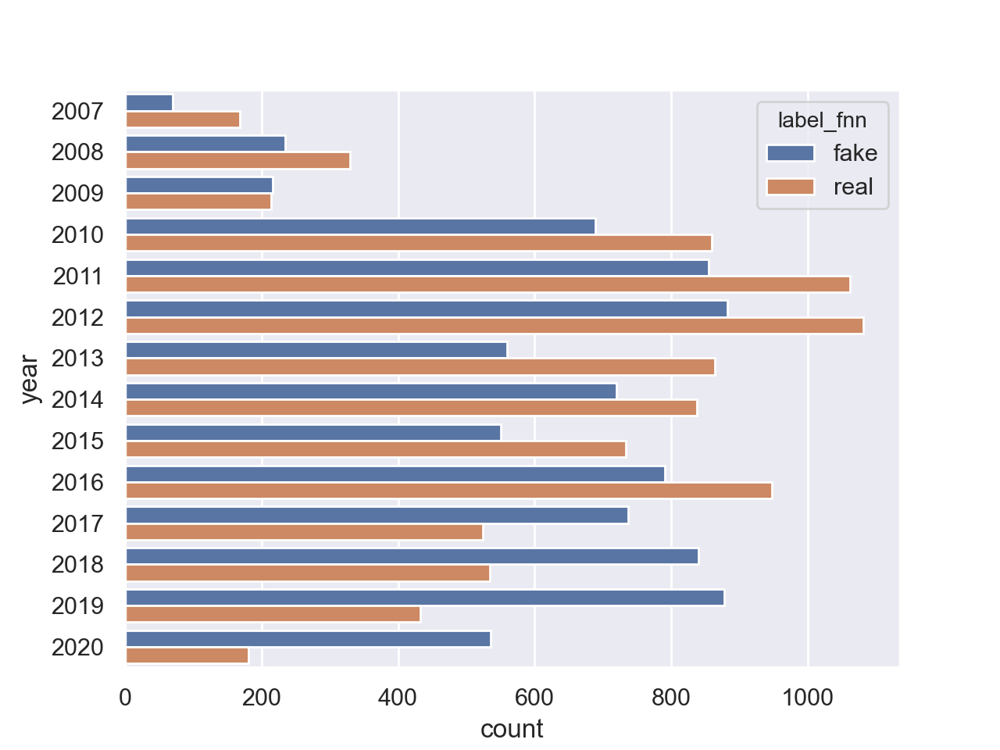

In [78]:
# look at real/fake by year
sns.countplot(y="year", hue="label_fnn", data=fnid);

<IPython.core.display.Javascript object>


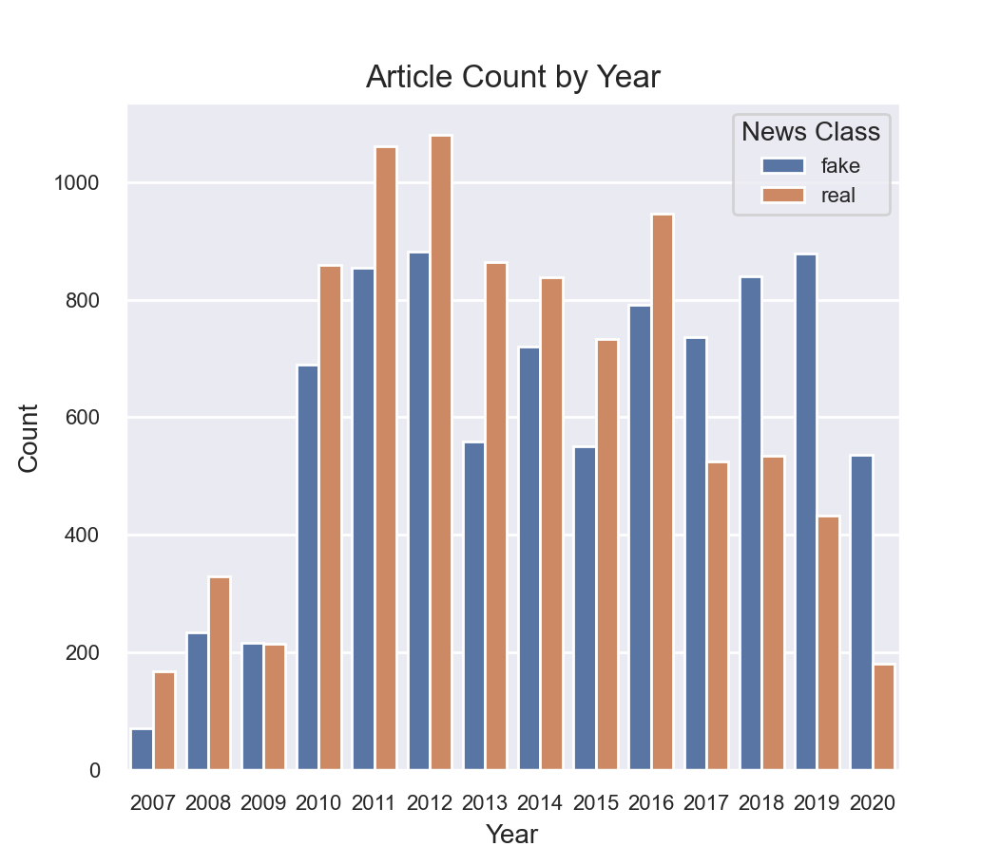

In [233]:
ax = sns.countplot(x="year", hue="label_fnn", data=fnid)
ax.set_xlabel('Year', fontsize=10)
ax.set_ylabel('Count', fontsize=10)
ax.legend(title='News Class', title_fontsize=10, prop=dict(size=8))
ax.tick_params(axis='x', labelsize=8) 
ax.tick_params(axis='y', labelsize=8)
ax.set_title('Article Count by Year', fontsize=12);

In [7]:
# group by date and get count
date_true = pd.DataFrame(fnid[fnid['label_fnn'] == 'real'].groupby("date2").size()).reset_index()
date_fake = pd.DataFrame(fnid[fnid['label_fnn'] == 'fake'].groupby("date2").size()).reset_index()

In [8]:
print(date_true.head())

date_true.rename(columns={0: "count"}, inplace=True)
date_fake.rename(columns={0: "count"}, inplace=True)

       date2  0
0 2007-05-02  1
1 2007-06-01  1
2 2007-06-12  2
3 2007-06-19  1
4 2007-06-21  1


In [55]:
# look at counts by date
layout = go.Layout(
    xaxis = go.layout.XAxis(title = go.layout.xaxis.Title(text='Date')),
    yaxis = go.layout.YAxis(title = go.layout.yaxis.Title(text='# Articles')))

fig = go.Figure(layout=layout)
fig.add_scatter(x=date_true['date2'], y=date_true['count'],mode='lines', line_color='rgb(0,176,246)', name = "True News")
fig.add_scatter(x=date_fake['date2'], y=date_fake['count'],mode='lines', name = "Fake News")
fig.show()

#### Article Length

In [9]:
# get word count
fnid['num_words'] = fnid["fullText_based_content"].apply(lambda x: len(x.split()))

fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,900
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,752
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,540
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,397
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,615


In [60]:
# average article length
print('Real average article length:', fnid[fnid['label_fnn']=='real']['num_words'].mean())
print('Fake average article length:', fnid[fnid['label_fnn']=='fake']['num_words'].mean())

Real average article length: 766.5363294171324
Fake average article length: 771.0248919013673


<IPython.core.display.Javascript object>


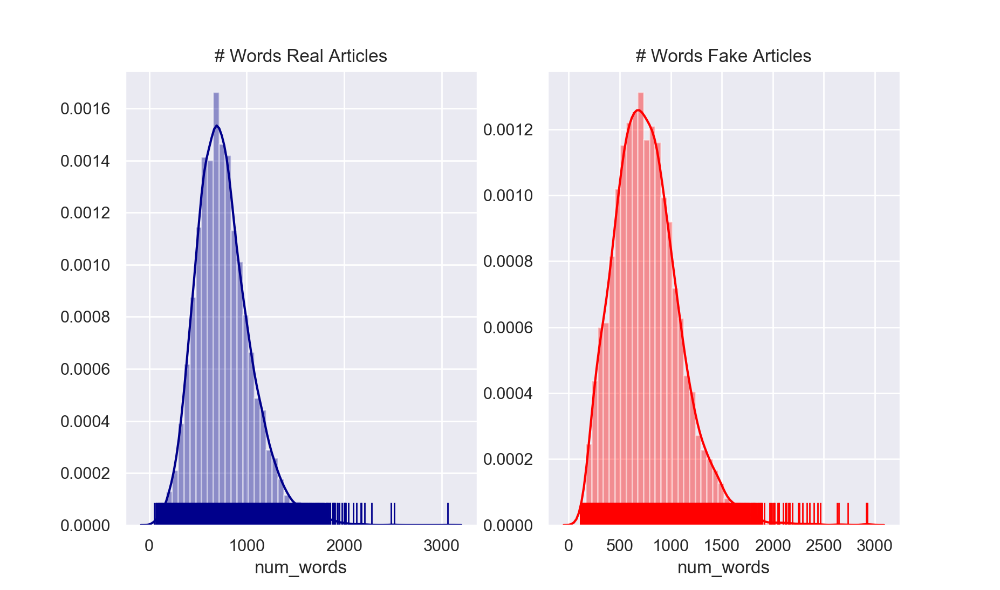

In [62]:
# plot word county distribution real/fake
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['num_words'], 
             ax = ax[0], color = "darkblue", rug = True).set_title("# Words Real Articles")
sns.distplot(fnid[fnid['label_fnn']=='fake']['num_words'],
             ax = ax[1], color = "red", rug = True).set_title("# Words Fake Articles");

<IPython.core.display.Javascript object>


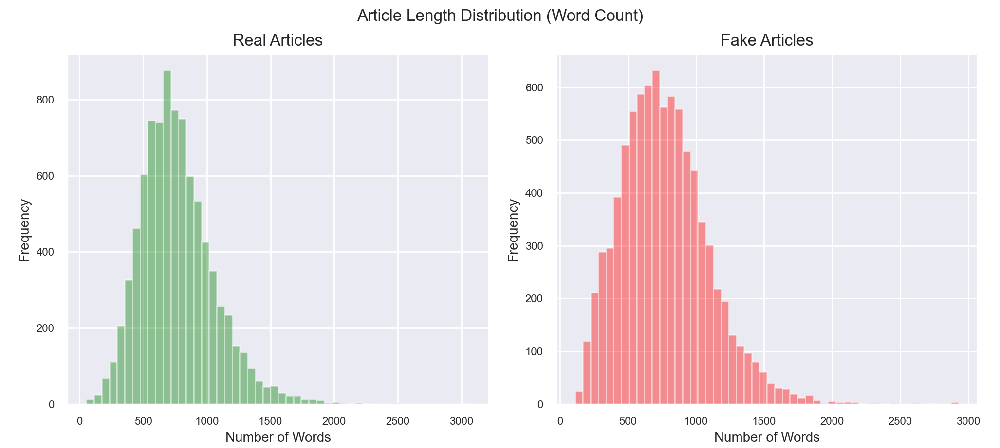

In [241]:
# plot word count distribution real/fake
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['num_words'], 
             ax = ax[0], color = "green", kde=False).set_title("Real Articles")
sns.distplot(fnid[fnid['label_fnn']=='fake']['num_words'],
             ax = ax[1], color = "red", kde=False).set_title("Fake Articles")

fig.suptitle("Article Length Distribution (Word Count)", fontsize=12)
ax[0].set_xlabel('Number of Words', fontsize=10)
ax[0].set_ylabel('Frequency', fontsize=10)
ax[0].tick_params(axis='x', labelsize=8) 
ax[0].tick_params(axis='y', labelsize=8)
ax[1].set_xlabel('Number of Words', fontsize=10)
ax[1].set_ylabel('Frequency', fontsize=10)
ax[1].tick_params(axis='x', labelsize=8) 
ax[1].tick_params(axis='y', labelsize=8)

fig.tight_layout()
fig.subplots_adjust(top=0.88);

#### Article Source

In [10]:
# clean up sources field
source_strip = lambda x: x["sources"].split(',')[0].replace('https://', '').replace('http://', '').split('/')[0][2:].strip()
fnid["source2"] = fnid.apply(source_strip, axis=1)

fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,900,blogs.tampabay.com
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,752,www.bobbyscott.house.gov
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,540,www.wispolitics.com
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,397,www.davearonberg.com
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,615,www.mystatesman.com


In [11]:
# youtube has multiple spellings
fnid[(fnid['source2']=='youtu.be')].head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2
8,11892,2016-02-11T14:21:04-05:00,Seminole Tribe of Florida,"The Seminole gambling compact offers ""$3 billi...","['https://youtu.be/6trsrsDedQY', 'http://www.f...",['The Seminole Tribe of Florida is trying to c...,The Seminole Tribe of Florida is trying to con...,real,2016-02-11,2016,1054,youtu.be
131,8149,2013-08-14T10:42:06-04:00,Mitch McConnell,Says Matt Bevin has repeatedly failed to pay h...,"['http://youtu.be/7r0K9Vl3lic', 'http://bevinb...",['The 2014 Kentucky Senate race will ultimatel...,The 2014 Kentucky Senate race will ultimately ...,fake,2013-08-14,2013,950,youtu.be
379,6452,2012-08-13T15:04:31-04:00,Barack Obama,"""We do know that Romney personally approved ov...","['http://youtu.be/DABbkpHzg3o', 'http://www.cn...",['Barack Obama expanded his assault on Mitt Ro...,Barack Obama expanded his assault on Mitt Romn...,real,2012-08-13,2012,1066,youtu.be
398,10606,2015-03-11T16:02:48-04:00,Jeb Bush,Eliminating affirmative action in admissions i...,"['http://youtu.be/lFdPJztLF5w', 'http://www.ny...",['Former Gov. Jeb Bush still hasn’t announced ...,Former Gov. Jeb Bush still hasn’t announced a ...,fake,2015-03-11,2015,636,youtu.be
485,17809,2020-01-28T06:00:00-05:00,Michael Bloomberg,"""Mayor Bloomberg helped lower the number of un...","['https://youtu.be/HXXZJ1lO5ig?t=17', 'https:/...","['Michael Bloomberg, the billionaire businessm...","Michael Bloomberg, the billionaire businessman...",real,2020-01-28,2020,681,youtu.be


In [12]:
# fix youtube
fnid['source2'].replace('youtu.be','www.youtube.com', inplace=True)

In [91]:
fnid[fnid['source2']==''].head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2
90,14083,2017-05-05T16:02:18-04:00,Ivanka Trump,"Says John Quincy Adams said, ""If your actions ...",[],['Ivanka Trump’s new book Women Who Work: Rewr...,Ivanka Trump’s new book Women Who Work: Rewrit...,fake,2017-05-05,2017,646,
108,11785,2016-01-20T18:27:37-05:00,Bernie Sanders,"""I have a D-minus voting record from the NRA.""",[],['Sen. Bernie Sanders is wearing a bad grade a...,Sen. Bernie Sanders is wearing a bad grade as ...,real,2016-01-20,2016,493,
147,4397,2011-09-07T06:00:00-04:00,Yolanda Adrean,"""We [the city of Atlanta] are overbuilt on hou...",[],['Anyone trying to sell real estate inside Atl...,Anyone trying to sell real estate inside Atlan...,real,2011-09-07,2011,755,
165,157,2007-11-01T00:00:00-04:00,Hillary Clinton,"""The Alternative Minimum Tax was never intende...",[],['The alternative minimum tax indeed was start...,The alternative minimum tax indeed was started...,real,2007-11-01,2007,269,
180,6880,2012-10-09T16:12:04-04:00,Amanda Fritz,"Says she ""oversaw an audit that won the city $...",[],['Portland City Council member Amanda Fritz ta...,Portland City Council member Amanda Fritz talk...,real,2012-10-09,2012,564,


In [138]:
# unique sources
len(list(set(fnid[fnid['source2']!='']['source2'])))

4072

<IPython.core.display.Javascript object>


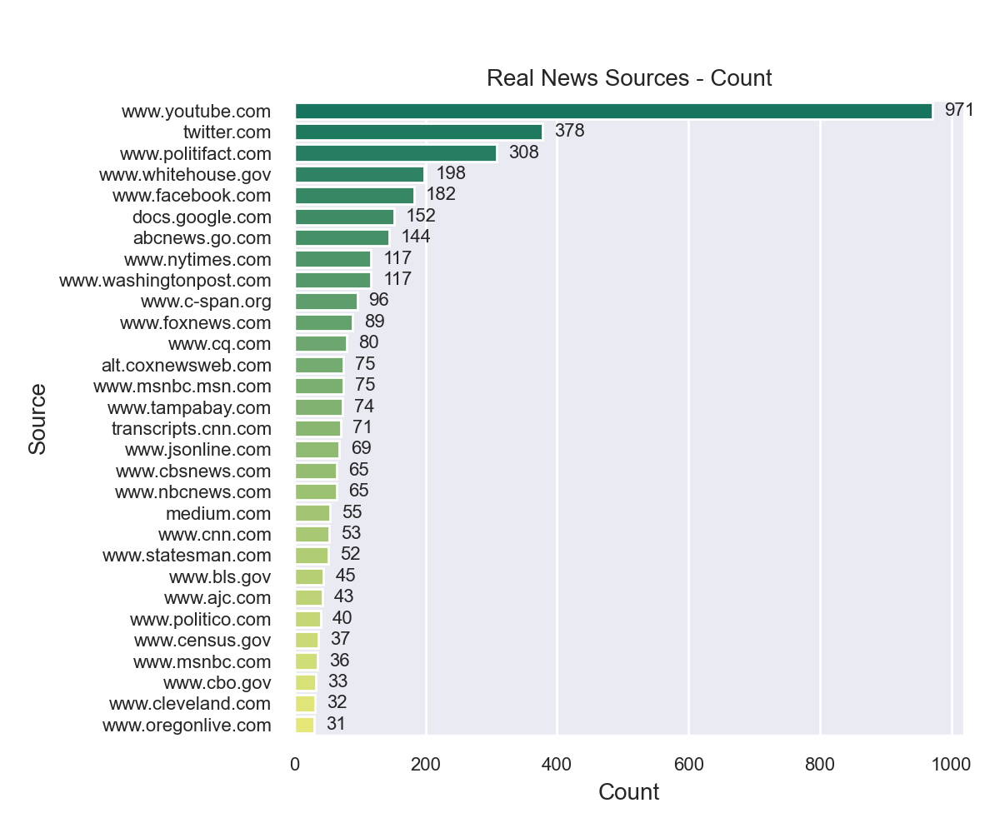

In [250]:
# count of real sources
fig, ax = plt.subplots(1, 1, figsize=(6, 5))
real_order=fnid[(fnid['label_fnn']=='real') & (fnid['source2']!='')]['source2'].value_counts().sort_values(ascending=False).iloc[:30].index
sns.countplot(data=fnid[(fnid['label_fnn']=='real') & (fnid['source2']!='')], y='source2', 
              order=real_order, ax=ax,
              palette='summer')
ax.set_title('Real News Sources - Count',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.xaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=10)
ax.set_ylabel('Source',fontsize=10)

for p in ax.patches:
    ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=8)
    
fig.tight_layout()
fig.subplots_adjust(top=0.88);

<IPython.core.display.Javascript object>


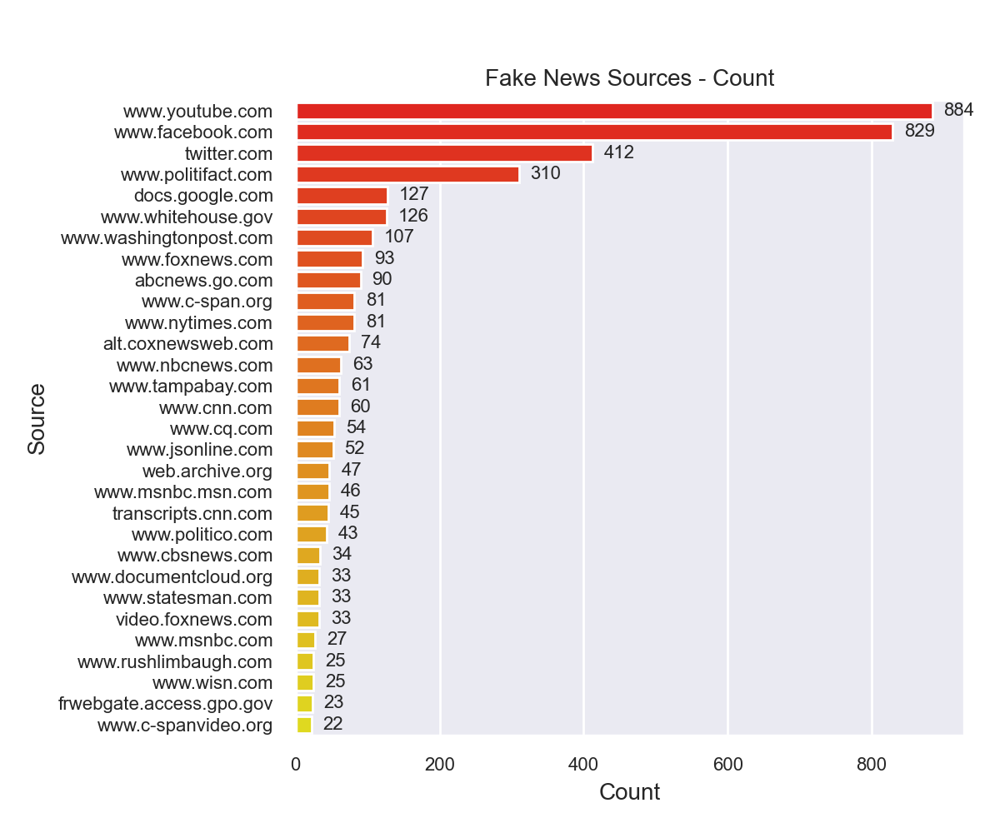

In [252]:
# count of real sources
fig, ax = plt.subplots(1, 1, figsize=(6, 5))
fake_order=fnid[(fnid['label_fnn']=='fake') & (fnid['source2']!='')]['source2'].value_counts().sort_values(ascending=False).iloc[:30].index
sns.countplot(data=fnid[(fnid['label_fnn']=='fake') & (fnid['source2']!='')], y='source2', 
              order=fake_order, ax=ax,
              palette='autumn')
ax.set_title('Fake News Sources - Count',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.xaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=10)
ax.set_ylabel('Source',fontsize=10)

for p in ax.patches:
    ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=8)
    
fig.tight_layout()
fig.subplots_adjust(top=0.88);

In [14]:
# find common sources between real/fake
fake_source = set(fnid[(fnid['label_fnn']=='fake') & (fnid['source2']!='')]['source2'])
real_source = set(fnid[(fnid['label_fnn']=='real') & (fnid['source2']!='')]['source2'])

common_source = list(fake_source.intersection(real_source))
len(common_source)

812

<IPython.core.display.Javascript object>


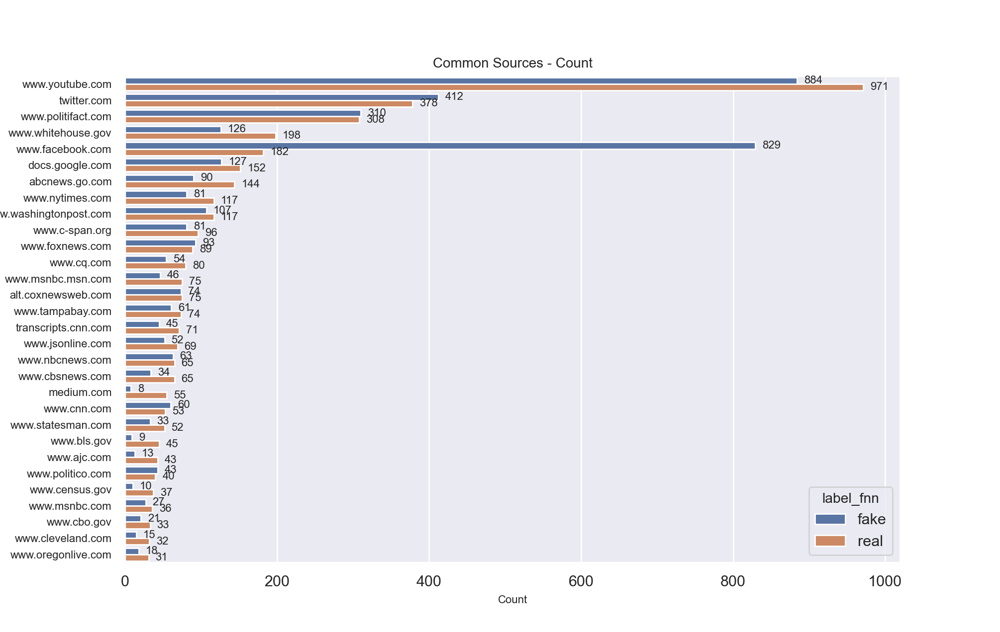

In [139]:
# plot common sources
ax=sns.countplot(data=fnid[fnid['source2'].isin(common_source)], 
                 y='source2', hue="label_fnn",
              order=real_order)
ax.set_title('Common Sources - Count',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=8)
ax.set_ylabel('Source',fontsize=8)

for p in ax.patches:
    ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=8);

#### Character Count

In [13]:
# get character count
fnid['num_chars'] = fnid["fullText_based_content"].apply(lambda x: len(x))

fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2,num_chars
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,900,blogs.tampabay.com,5222
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,752,www.bobbyscott.house.gov,4351
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,540,www.wispolitics.com,3336
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,397,www.davearonberg.com,2366
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,615,www.mystatesman.com,3762


<IPython.core.display.Javascript object>


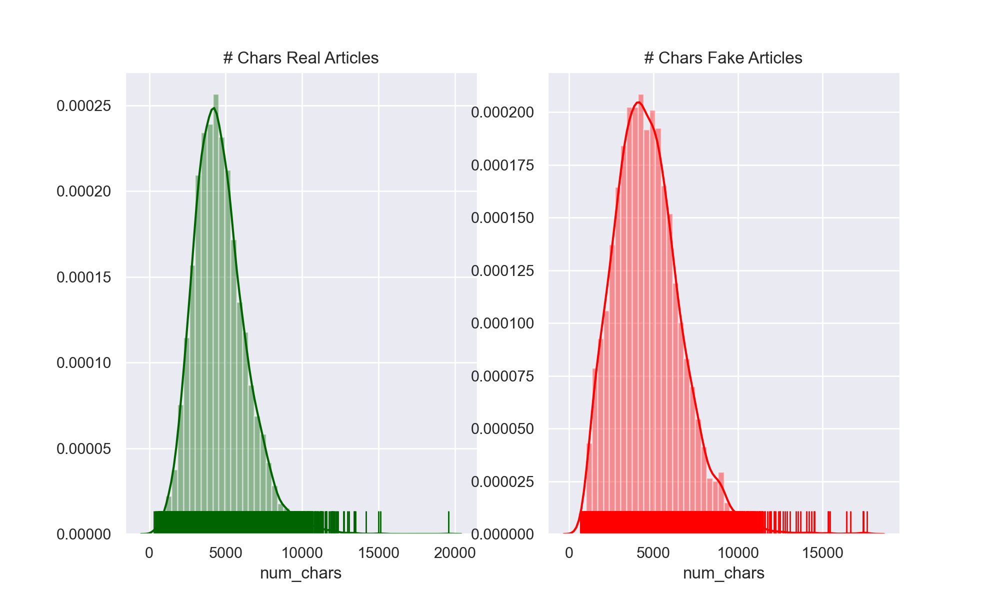

In [125]:
# real/fake character count
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['num_chars'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("# Chars Real Articles")
sns.distplot(fnid[fnid['label_fnn']=='fake']['num_chars'],
             ax = ax[1], color = "red", rug = True).set_title("# Chars Fake Articles");

In [194]:
# exclamation points
print('Real ! count:', fnid[fnid['label_fnn']=='real']["fullText_based_content"].str.count("!").sum())
print('Fake ! count:', fnid[fnid['label_fnn']=='fake']["fullText_based_content"].str.count("!").sum())

Real ! count: 652
Fake ! count: 1794


In [203]:
# get counts of ! per row
fnid["num_excl"] = fnid["fullText_based_content"].str.count("!")
fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,...,neu,pos,compound,emotions,Happy,Angry,Surprise,Sad,Fear,num_excl
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,...,0.783,0.143,0.9862,"{'Happy': 0.09, 'Angry': 0.01, 'Surprise': 0.2...",0.09,0.01,0.28,0.30,0.32,0
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,...,0.694,0.121,-0.9690,"{'Happy': 0.04, 'Angry': 0.0, 'Surprise': 0.54...",0.04,0.00,0.54,0.10,0.32,0
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,...,0.871,0.108,0.9729,"{'Happy': 0.01, 'Angry': 0.09, 'Surprise': 0.2...",0.01,0.09,0.21,0.10,0.60,0
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,...,0.696,0.287,0.9968,"{'Happy': 0.22, 'Angry': 0.0, 'Surprise': 0.25...",0.22,0.00,0.25,0.11,0.42,0
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,...,0.926,0.035,-0.4019,"{'Happy': 0.04, 'Angry': 0.03, 'Surprise': 0.2...",0.04,0.03,0.21,0.26,0.47,1


In [210]:
# group by target
ex_counts = fnid.groupby(['label_fnn'])[['num_excl']].sum().reset_index()

In [304]:
fnid.groupby(['label_fnn'])[['num_excl']].sum()

,num_excl
label_fnn,
fake,1794
real,652


In [305]:
fnid.groupby(['label_fnn'])[['num_excl']].mean()

,num_excl
label_fnn,
fake,0.209653
real,0.074370


<IPython.core.display.Javascript object>


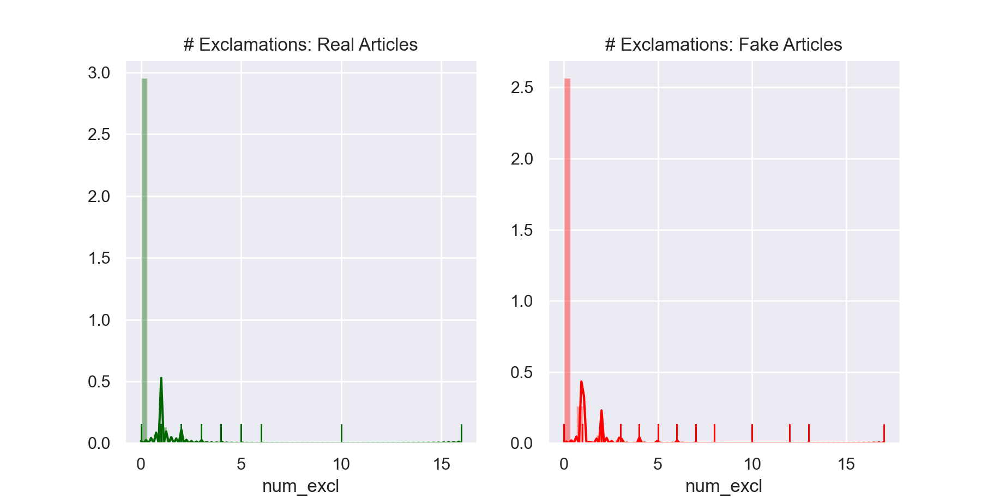

In [204]:
# real/fake character count - excl
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['num_excl'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("# Exclamations: Real Articles")
sns.distplot(fnid[fnid['label_fnn']=='fake']['num_excl'],
             ax = ax[1], color = "red", rug = True).set_title("# Exclamations: Fake Articles");

<IPython.core.display.Javascript object>


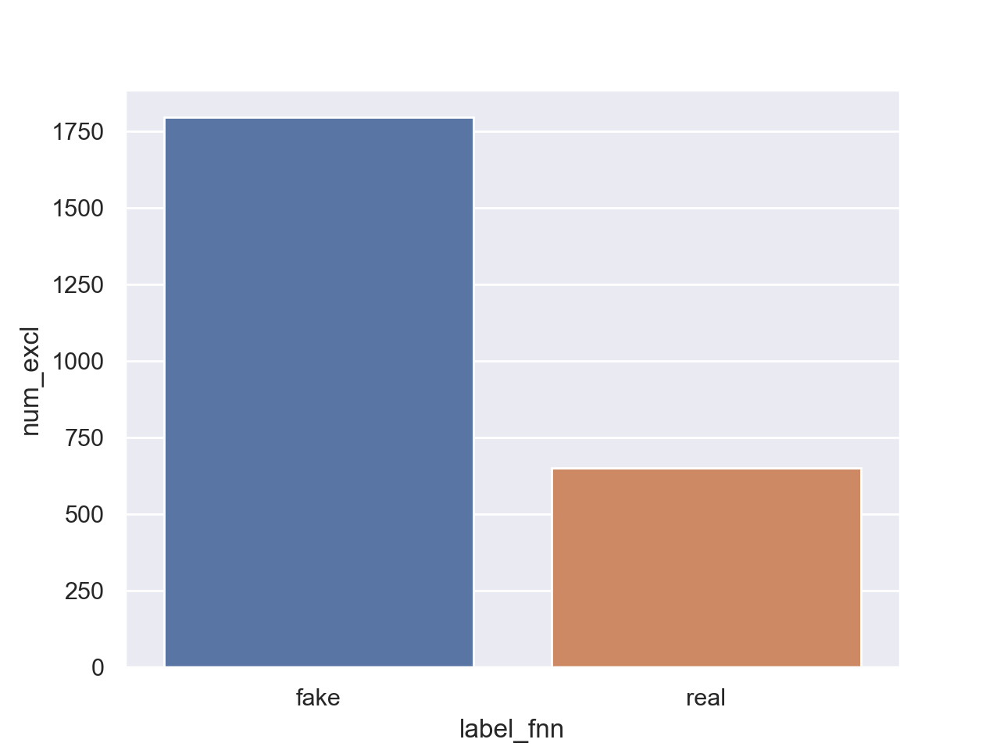

In [211]:
# look at real/fake by year - exclamation
sns.barplot(x="label_fnn", y="num_excl", data=ex_counts, errwidth=0);

In [219]:
# quotation marks
print('Real \" count:', fnid[fnid['label_fnn']=='real']["fullText_based_content"].str.count("\"").sum())
print('Fake \" count:', fnid[fnid['label_fnn']=='fake']["fullText_based_content"].str.count("\"").sum())
print('Real \' count:', fnid[fnid['label_fnn']=='real']["fullText_based_content"].str.count("\'").sum())
print('Fake \' count:', fnid[fnid['label_fnn']=='fake']["fullText_based_content"].str.count("\'").sum())

Real " count: 154574
Fake " count: 174561
Real ' count: 40850
Fake ' count: 40213


<IPython.core.display.Javascript object>


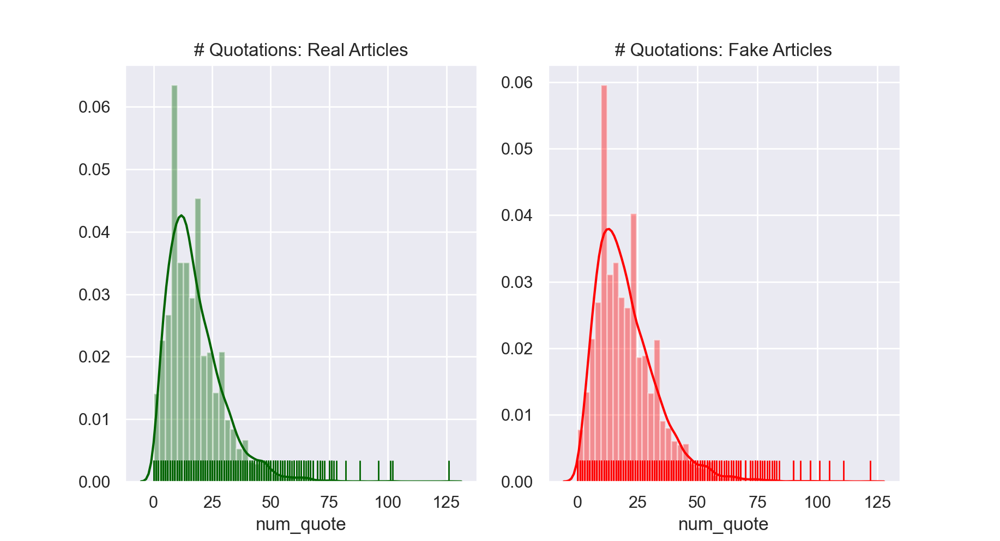

In [217]:
# plot quotations real/fake
fnid["num_quote"] = fnid["fullText_based_content"].str.count("\"")
quote_counts = fnid.groupby(['label_fnn'])[['num_quote']].sum().reset_index()

fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['num_quote'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("# Quotations: Real Articles")
sns.distplot(fnid[fnid['label_fnn']=='fake']['num_quote'],
             ax = ax[1], color = "red", rug = True).set_title("# Quotations: Fake Articles");

In [307]:
fnid.groupby(['label_fnn'])[['num_quote']].mean()

,num_quote
label_fnn,
fake,20.399790
real,17.631345


In [308]:
fnid["num_quote_single"] = fnid["fullText_based_content"].str.count("\'")
fnid.groupby(['label_fnn'])[['num_quote_single']].mean()

,num_quote_single
label_fnn,
fake,4.699427
real,4.659519


<IPython.core.display.Javascript object>


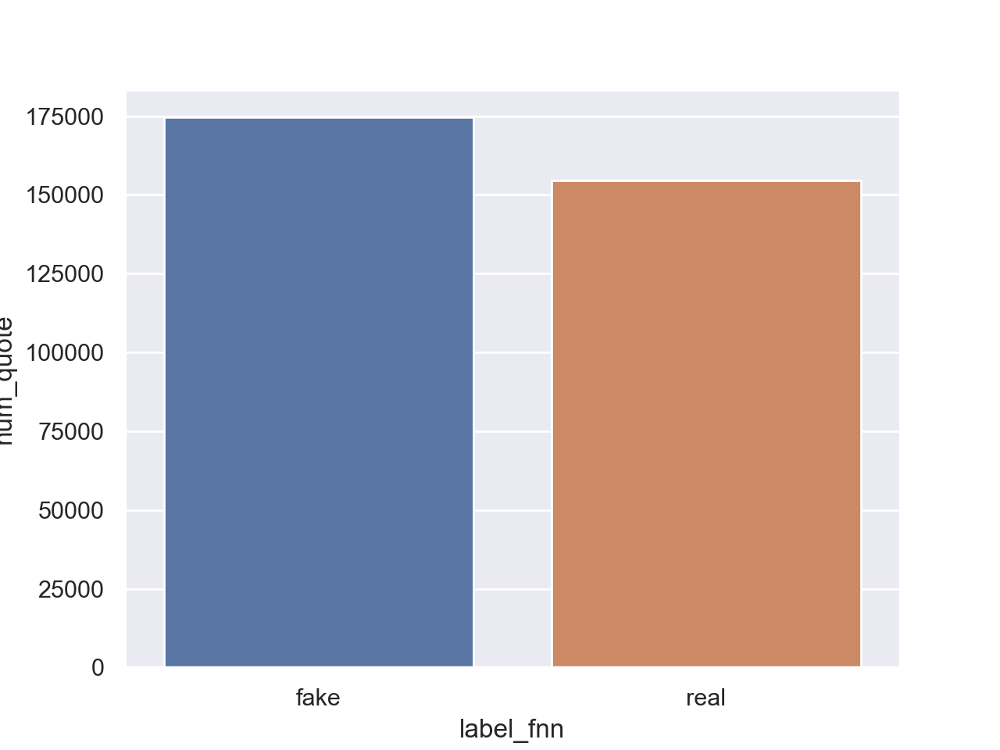

In [218]:
# look at real/fake by year - quotations
sns.barplot(x="label_fnn", y="num_quote", data=quote_counts, errwidth=0);

#### Text Preprocessing
Remove strip extra spaces, punctuation, lower-case

In [15]:
# get stop words
import gensim
from nltk.corpus import stopwords
from gensim.parsing.preprocessing import STOPWORDS

In [16]:
# strip spaces and punctuation and lower case
fnid["clean_text"] = fnid["fullText_based_content"].str.strip()
fnid["clean_text"] = fnid["clean_text"].str.replace('[^\w\s]','')
fnid["clean_text"] = fnid["clean_text"].str.lower()
fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2,num_chars,clean_text
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,900,blogs.tampabay.com,5222,gov charlie crist launched what amounts to a n...
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,752,www.bobbyscott.house.gov,4351,us rep bobby scott d3rd was not pleased with t...
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,540,www.wispolitics.com,3336,amid reports questioning foxconn technology gr...
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,397,www.davearonberg.com,2366,state sen dave aronberg a democratic candidate...
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,615,www.mystatesman.com,3762,from the citrus of the rio grande valley to th...


#### Word Clouds
Look at stop words from multiple packages - `ntlk` and `gensim`

In [ ]:
from wordcloud import WordCloud

In [17]:
nltk_stop = set(stopwords.words('english'))
gensim_stop = set(STOPWORDS)

<IPython.core.display.Javascript object>


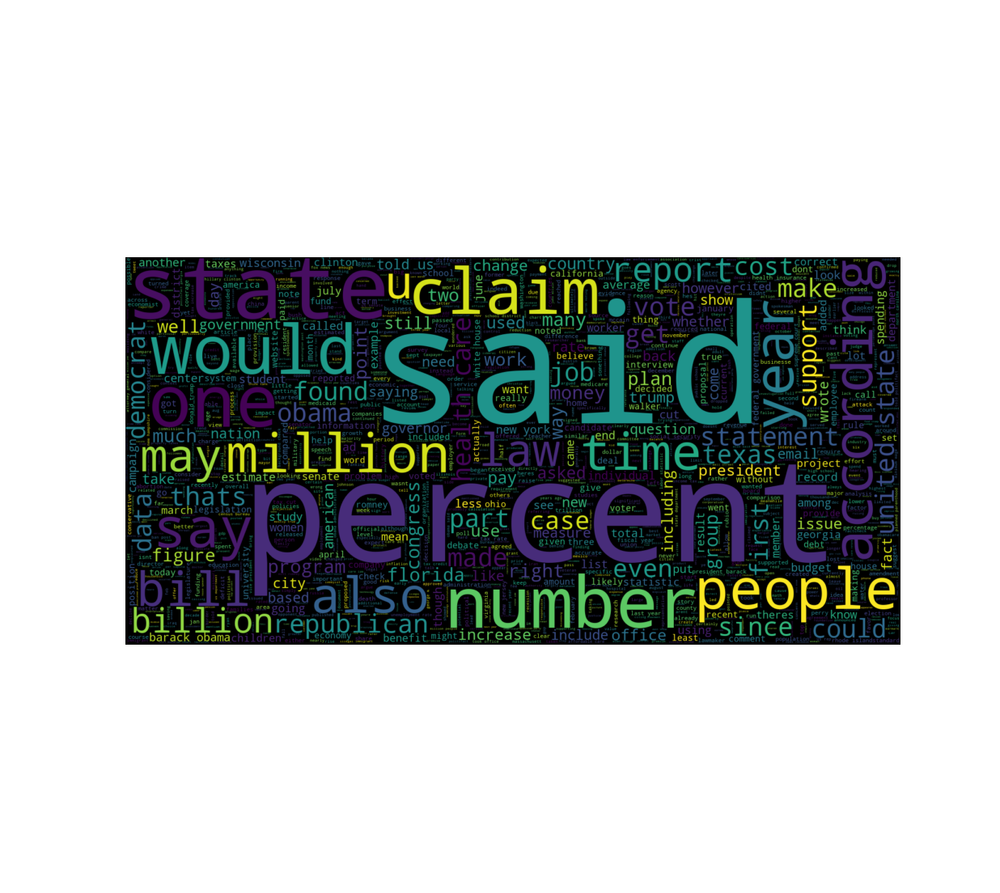

In [155]:
# word clouds - real - nltk
fig, ax = plt.subplots()
wc_real = WordCloud(max_words = 2000 , width = 1600 , height = 800 , 
                    stopwords = nltk_stop).generate(" ".join(fnid[fnid['label_fnn']=='real']['clean_text']))
ax.imshow(wc_real , interpolation = 'bilinear')
ax.axis('off');

<IPython.core.display.Javascript object>


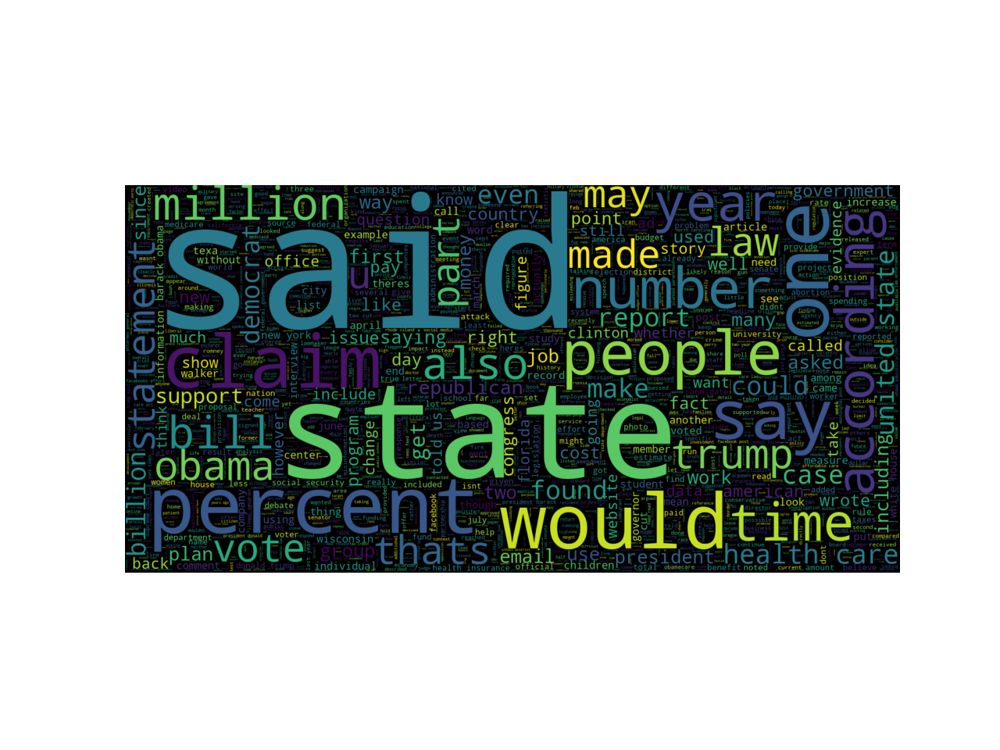

In [156]:
# word clouds - fake - nltk
fig, ax = plt.subplots()
wc_real = WordCloud(max_words = 2000 , width = 1600 , height = 800 , 
                    stopwords = nltk_stop).generate(" ".join(fnid[fnid['label_fnn']=='fake']['clean_text']))
ax.imshow(wc_real , interpolation = 'bilinear')
ax.axis('off');

<IPython.core.display.Javascript object>


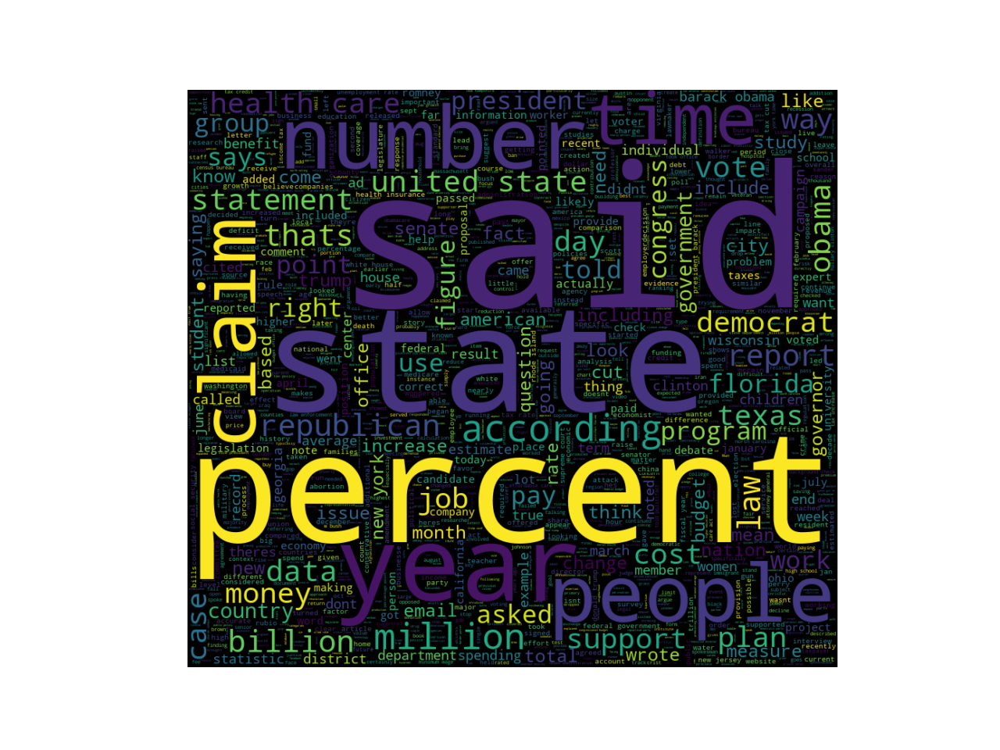

In [157]:
# word clouds - real - gensim
fig, ax = plt.subplots()
wc_real = WordCloud(max_words = 2000 , width = 900 , height = 800 , 
                    stopwords = gensim_stop).generate(" ".join(fnid[fnid['label_fnn']=='real']['clean_text']))
ax.imshow(wc_real , interpolation = 'bilinear')
ax.axis('off');

<IPython.core.display.Javascript object>


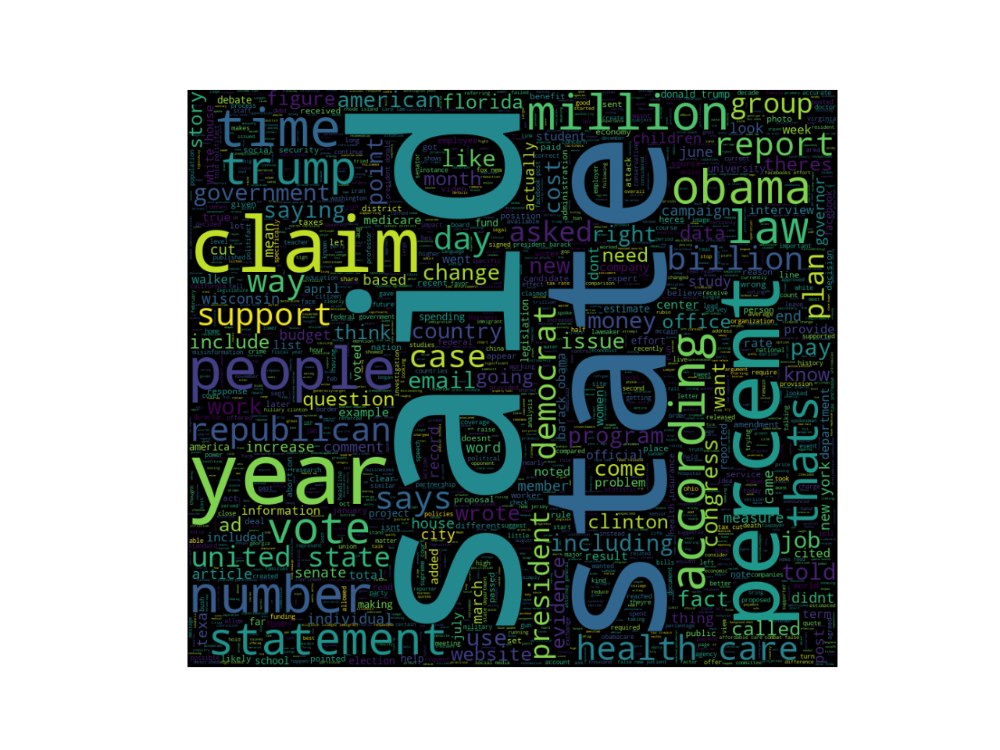

In [158]:
# word clouds - fake - gensim
fig, ax = plt.subplots()
wc_real = WordCloud(max_words = 2000 , width = 900 , height = 800 , 
                    stopwords = gensim_stop).generate(" ".join(fnid[fnid['label_fnn']=='fake']['clean_text']))
ax.imshow(wc_real , interpolation = 'bilinear')
ax.axis('off');

<IPython.core.display.Javascript object>


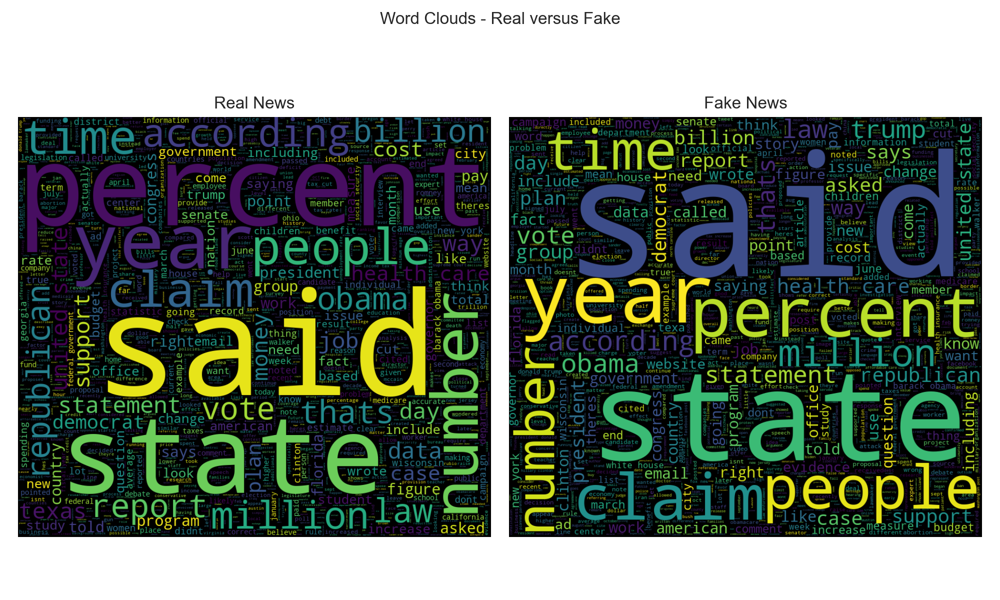

In [274]:
fig, ax = plt.subplots(1, 2, figsize=(10, 6))

wc_real = WordCloud(max_words = 2000 , width = 900 , height = 800 , 
                    stopwords = gensim_stop).generate(" ".join(fnid[fnid['label_fnn']=='real']['clean_text']))

wc_fake = WordCloud(max_words = 2000 , width = 900 , height = 800 , 
                    stopwords = gensim_stop).generate(" ".join(fnid[fnid['label_fnn']=='fake']['clean_text']))

ax[0].imshow(wc_real , interpolation = 'bilinear')
ax[0].set_title('Real News')
ax[0].axis('off')
ax[1].imshow(wc_fake , interpolation = 'bilinear')
ax[1].set_title('Fake News')
ax[1].axis('off')
fig.suptitle('Word Clouds - Real versus Fake', fontsize=12)

fig.tight_layout()
fig.subplots_adjust(top=0.88);

#### Additional Processing
Remove stop words, lemmatize, tokenize

In [113]:
from nltk.stem import WordNetLemmatizer 
from nltk.tokenize import word_tokenize
from nltk.util import ngrams
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer

In [18]:
# remove stop words - gensim
fnid["clean_text2"] = fnid["clean_text"].apply(lambda x: ' '.join([word for word in x.split() if word not in (gensim_stop)]))
fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2,num_chars,clean_text,clean_text2
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,900,blogs.tampabay.com,5222,gov charlie crist launched what amounts to a n...,gov charlie crist launched amounts nuclear att...
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,752,www.bobbyscott.house.gov,4351,us rep bobby scott d3rd was not pleased with t...,rep bobby scott d3rd pleased debt limit deal l...
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,540,www.wispolitics.com,3336,amid reports questioning foxconn technology gr...,amid reports questioning foxconn technology gr...
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,397,www.davearonberg.com,2366,state sen dave aronberg a democratic candidate...,state sen dave aronberg democratic candidate a...
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,615,www.mystatesman.com,3762,from the citrus of the rio grande valley to th...,citrus rio grande valley peaches texas hill co...


In [160]:
lemmatizer = WordNetLemmatizer()  

def token_text(df):
    word_list = []
    for article in (df['clean_text2']):
        words = word_tokenize(article)
        words = [lemmatizer.lemmatize(word) for word in words]
        for w in words:
            word_list.append(w)
    return word_list
        
    
full_token = token_text(fnid)

In [162]:
# pickle list so don't have to run again
with open("full_token.txt", "wb") as fp:   
    pickle.dump(full_token, fp)

# unpickle 
#with open("full_token.txt", "rb") as fp:   
#    b = pickle.load(fp)

In [164]:
# do for true and false news
true_token = token_text(fnid[fnid['label_fnn']=='real'])
false_token = token_text(fnid[fnid['label_fnn']=='fake'])

with open("true_token.txt", "wb") as fp:   
    pickle.dump(true_token, fp)
    
with open("false_token.txt", "wb") as fp:   
    pickle.dump(false_token, fp)

#### N-gram analysis
Look at unigram, bigram, trigram - for full text, real news, fake news

In [169]:
# nltk ngrams - a little slow
pd.Series(ngrams(full_token, 2)).value_counts()[:20]

(health, care)           9833
(united, state)          9823
(new, york)              5696
(white, house)           3984
(social, security)       3605
(barack, obama)          3502
(federal, government)    3280
(health, insurance)      3269
(tax, cut)               3258
(president, barack)      3253
(donald, trump)          3165
(income, tax)            2695
(fiscal, year)           2563
(tax, rate)              2513
(new, jersey)            2498
(supreme, court)         2453
(property, tax)          2132
(rhode, island)          2062
(told, politifact)       1979
(care, act)              1926
dtype: int64

In [110]:
# top n-grams - kind of slow
def top_ngram(data, n=2, top=20):
    vector = CountVectorizer(ngram_range=(n, n)).fit(data)
    bow = vector.transform(data)
    sum_words = bow.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) 
                  for word, idx in vector.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:top]

In [178]:
# full text n gram
uni_full = top_ngram(full_token, 1)
bi_full = pd.Series(ngrams(full_token, 2)).value_counts()[:20]
tri_full = pd.Series(ngrams(full_token, 3)).value_counts()[:20]

<IPython.core.display.Javascript object>


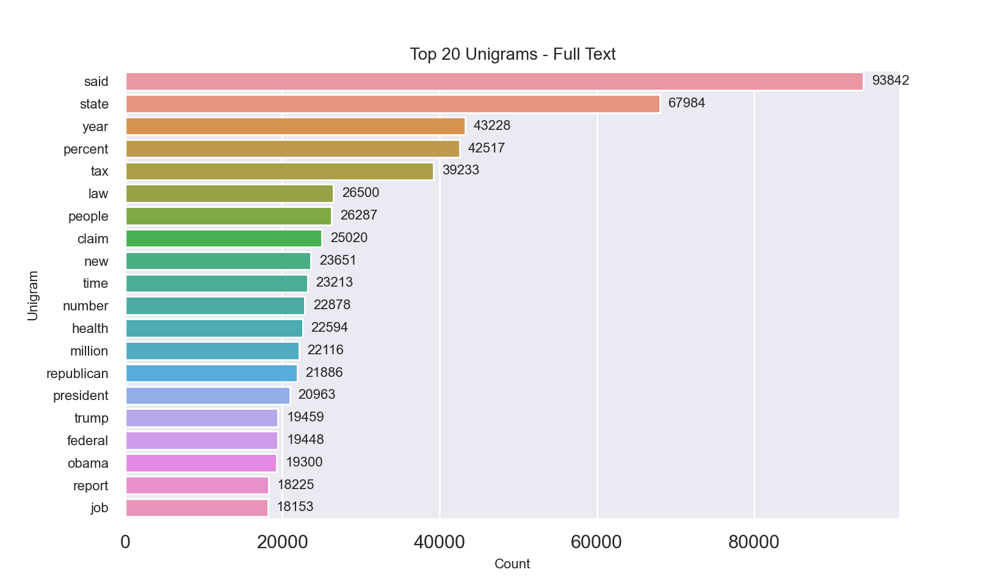

In [180]:
# full text unigram
x,y = map(list,zip(*uni_full))
ax=sns.barplot(x=y,y=x)
ax.set_title('Top 20 Unigrams - Full Text',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=8)
ax.set_ylabel('Unigram',fontsize=8)

for p in ax.patches:
    ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=8);

In [173]:
uni_full[:4]

[('said', 93842), ('state', 67984), ('year', 43228), ('percent', 42517)]

In [109]:
# plot n grams
def plot_ngram(ngram_list, text1, text2):
    ngram_df = ngram_list.to_frame().reset_index()
    ngram_df.columns = ['idx', 'count']
    tup_string = lambda x: ' '.join(x['idx'])
    ngram_df['words'] = ngram_df.apply(tup_string, axis=1)
    
    ax=sns.barplot(x='count',y='words', data=ngram_df)
    ax.set_title('Top 20 {}s - {} Text'.format(text1, text2),fontsize=10)
    ax.yaxis.set_tick_params(labelsize=8)
    ax.set_xlabel('Count', fontsize=8)
    ax.set_ylabel(text1 ,fontsize=8)

    for p in ax.patches:
        ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=8);

<IPython.core.display.Javascript object>


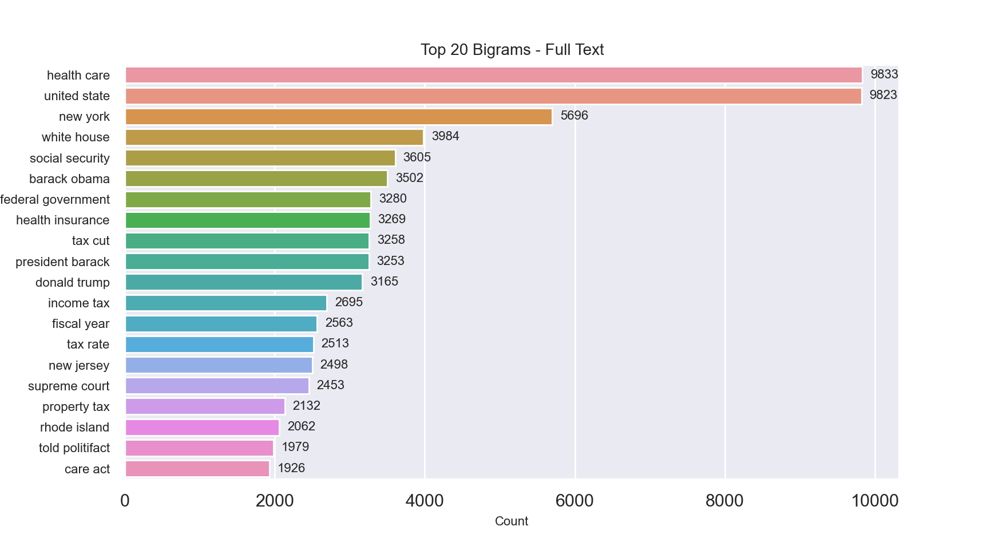

In [196]:
# full text bigram
plot_ngram(bi_full, 'Bigram', 'Full')

<IPython.core.display.Javascript object>


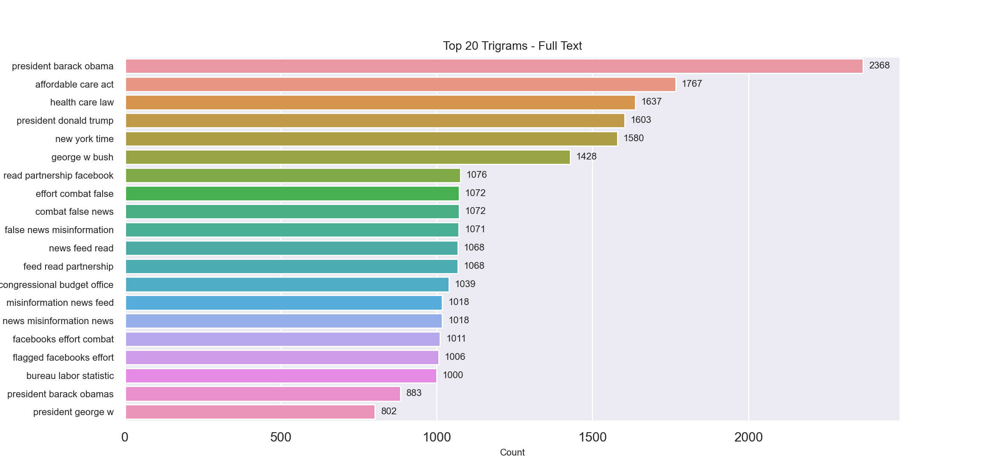

In [201]:
# full text trigram
plot_ngram(tri_full, 'Trigram', 'Full')

In [198]:
# true text n gram
uni_true = top_ngram(true_token, 1)
bi_true = pd.Series(ngrams(true_token, 2)).value_counts()[:20]
tri_true = pd.Series(ngrams(true_token, 3)).value_counts()[:20]

<IPython.core.display.Javascript object>


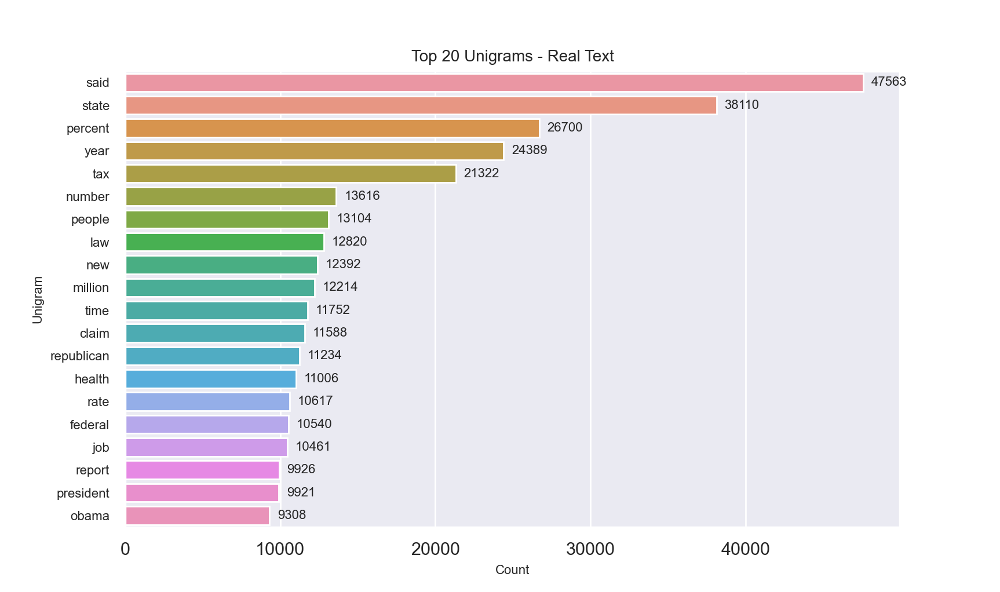

In [202]:
# real text unigram
x,y = map(list,zip(*uni_true))
ax=sns.barplot(x=y,y=x)
ax.set_title('Top 20 Unigrams - Real Text',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=8)
ax.set_ylabel('Unigram',fontsize=8)

for p in ax.patches:
    ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=8);

<IPython.core.display.Javascript object>


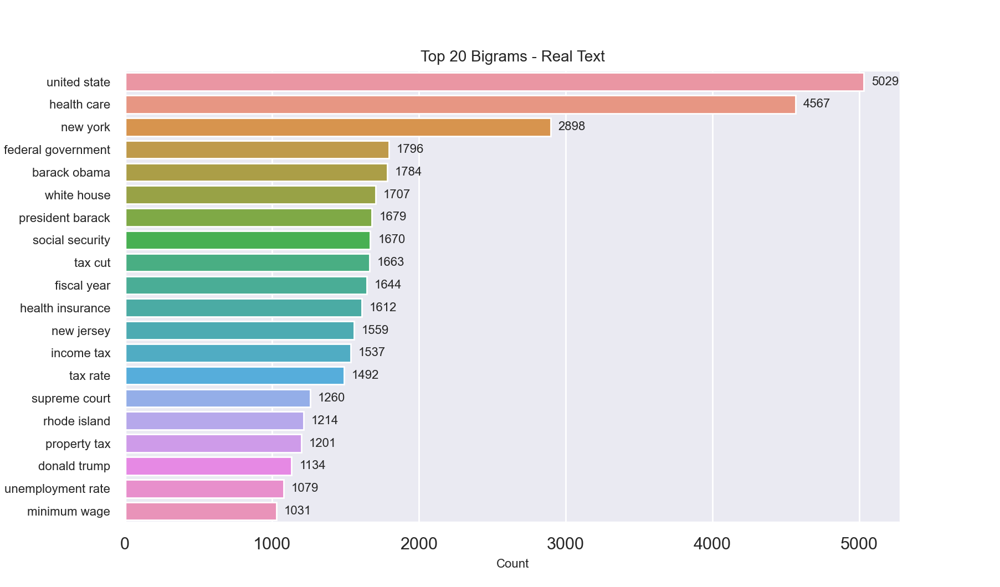

In [209]:
# true text bigram
plot_ngram(bi_true, 'Bigram', 'Real')

In [268]:
import pickle
from nltk.util import ngrams

with open("true_token.txt", "rb") as fp:   
    true_token = pickle.load(fp)

with open("false_token.txt", "rb") as fp:   
    false_token = pickle.load(fp)
    
bi_true = pd.Series(ngrams(true_token, 2)).value_counts()[:20]
bi_fake = pd.Series(ngrams(false_token, 2)).value_counts()[:20]

<IPython.core.display.Javascript object>


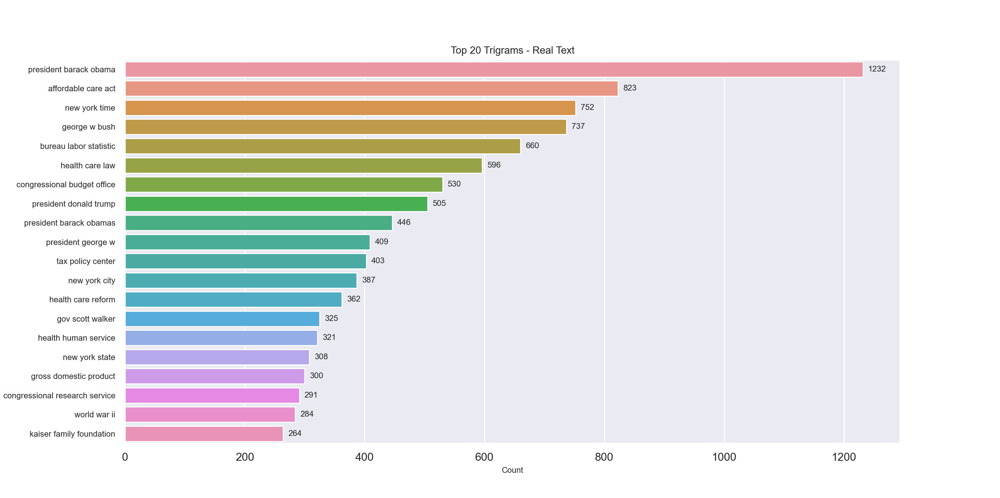

In [210]:
# true text trigram
plot_ngram(tri_true, 'Trigram', 'Real')

In [200]:
# false text n gram
uni_fake = top_ngram(false_token, 1)
bi_fake = pd.Series(ngrams(false_token, 2)).value_counts()[:20]
tri_fake = pd.Series(ngrams(false_token, 3)).value_counts()[:20]

<IPython.core.display.Javascript object>


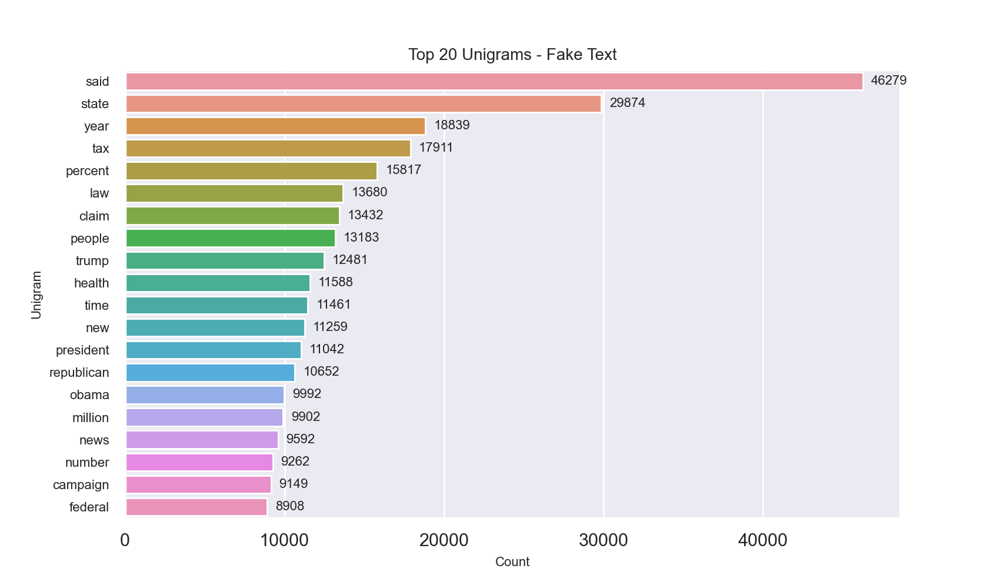

In [211]:
# fake text unigram
x,y = map(list,zip(*uni_fake))
ax=sns.barplot(x=y,y=x)
ax.set_title('Top 20 Unigrams - Fake Text',fontsize=10)
ax.yaxis.set_tick_params(labelsize=8)
ax.set_xlabel('Count', fontsize=8)
ax.set_ylabel('Unigram',fontsize=8)

for p in ax.patches:
    ax.annotate("%.f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center", fontsize=8);

<IPython.core.display.Javascript object>


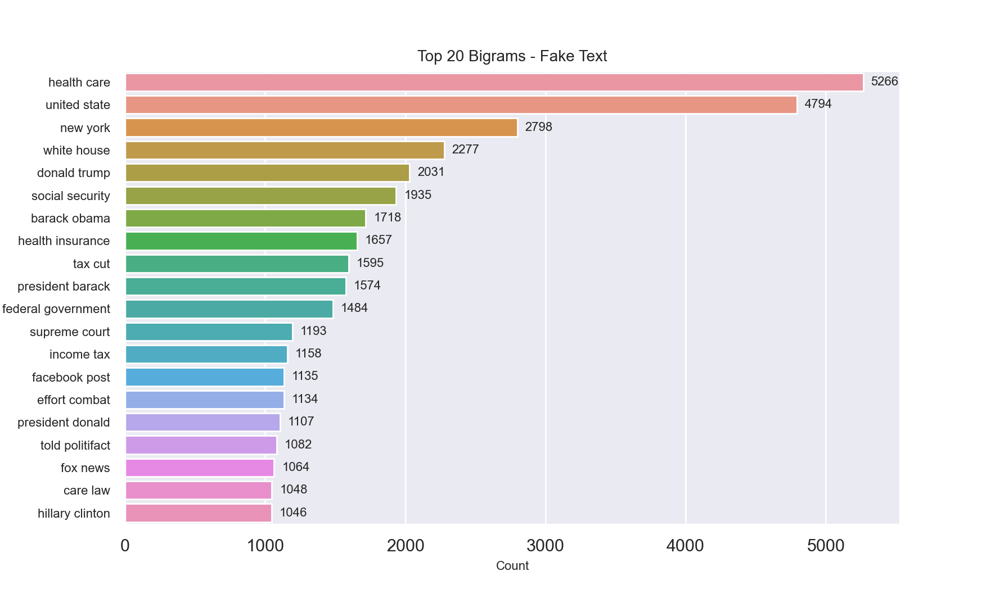

In [212]:
# fake text bigram
plot_ngram(bi_fake, 'Bigram', 'Fake')

<IPython.core.display.Javascript object>


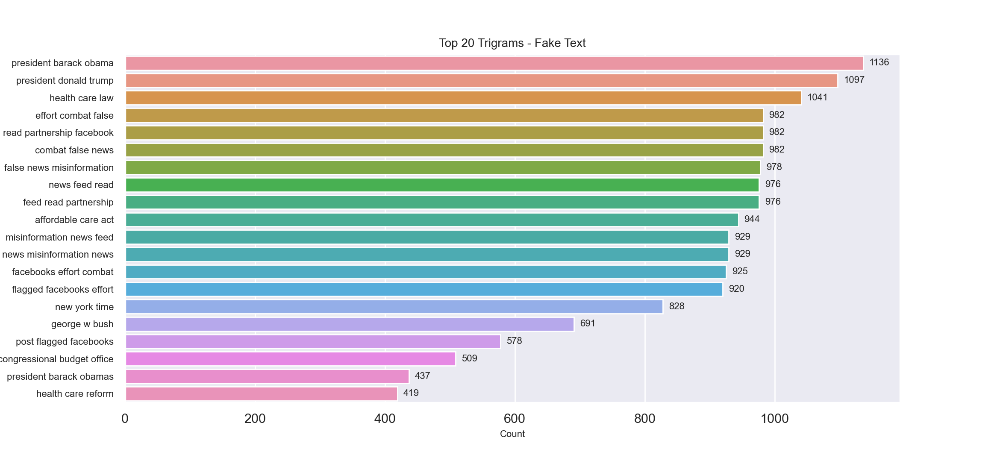

In [213]:
# fake text trigram
plot_ngram(tri_fake, 'Trigram', 'Fake')

In [224]:
# pickle list so don't have to run again
with open("uni_full.txt", "wb") as fp:   
    pickle.dump(uni_full, fp)
    
with open("bi_full.txt", "wb") as fp:   
    pickle.dump(bi_full, fp)
    
with open("tri_full.txt", "wb") as fp:   
    pickle.dump(tri_full, fp)

with open("uni_true.txt", "wb") as fp:   
    pickle.dump(uni_true, fp)
    
with open("bi_true.txt", "wb") as fp:   
    pickle.dump(bi_true, fp)
    
with open("tri_true.txt", "wb") as fp:   
    pickle.dump(tri_true, fp)    

with open("uni_fake.txt", "wb") as fp:   
    pickle.dump(uni_fake, fp)
    
with open("bi_fake.txt", "wb") as fp:   
    pickle.dump(bi_fake, fp)
    
with open("tri_fake.txt", "wb") as fp:   
    pickle.dump(tri_fake, fp)
    
# unpickle 
#with open("full_token.txt", "rb") as fp:   
#    b = pickle.load(fp)

#### Sentiment Analysis
Using multiple packages - `nltk` VADER, `textblob`, `text2emotion`

In [ ]:
# load packages
from textblob import TextBlob
import text2emotion as te
from nltk.sentiment.vader import SentimentIntensityAnalyzer

In [28]:
# nltk - vader sentiment
analyzer = SentimentIntensityAnalyzer()

# get positive, negative, neutral, compound scores
fnid['neg'] = fnid['clean_text2'].apply(lambda x:analyzer.polarity_scores(x)['neg'])
fnid['neu'] = fnid['clean_text2'].apply(lambda x:analyzer.polarity_scores(x)['neu'])
fnid['pos'] = fnid['clean_text2'].apply(lambda x:analyzer.polarity_scores(x)['pos'])
fnid['compound'] = fnid['clean_text2'].apply(lambda x:analyzer.polarity_scores(x)['compound'])
fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2,num_chars,clean_text,clean_text2,polarity,neg,neu,pos,compound
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,900,blogs.tampabay.com,5222,gov charlie crist launched what amounts to a n...,gov charlie crist launched amounts nuclear att...,0.021587,0.074,0.783,0.143,0.9862
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,752,www.bobbyscott.house.gov,4351,us rep bobby scott d3rd was not pleased with t...,rep bobby scott d3rd pleased debt limit deal l...,0.010920,0.185,0.694,0.121,-0.9690
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,540,www.wispolitics.com,3336,amid reports questioning foxconn technology gr...,amid reports questioning foxconn technology gr...,0.123333,0.021,0.871,0.108,0.9729
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,397,www.davearonberg.com,2366,state sen dave aronberg a democratic candidate...,state sen dave aronberg democratic candidate a...,0.363294,0.017,0.696,0.287,0.9968
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,615,www.mystatesman.com,3762,from the citrus of the rio grande valley to th...,citrus rio grande valley peaches texas hill co...,0.048551,0.039,0.926,0.035,-0.4019


In [217]:
# export dataframe - so reload next time
fnid.to_csv('fnid_with_sentiment1.csv') 

# fnid = pd.read_csv('fnid_with_sentiment1.csv')

In [225]:
# average sentiment 
print('Real average negativity:', fnid[fnid['label_fnn']=='real']['neg'].mean())
print('Fake average negativity:', fnid[fnid['label_fnn']=='fake']['neg'].mean())

print('Real average positivity:', fnid[fnid['label_fnn']=='real']['pos'].mean())
print('Fake average positivity:', fnid[fnid['label_fnn']=='fake']['pos'].mean())

print('Real average compound sentiment:', fnid[fnid['label_fnn']=='real']['compound'].mean())
print('Fake average compound sentiment:', fnid[fnid['label_fnn']=='fake']['compound'].mean())

Real average negativity: 0.09312056575795598
Fake average negativity: 0.10295816290756106
Real average positivity: 0.11986608874187293
Fake average positivity: 0.11694098398971602
Real average compound sentiment: 0.29859731949355534
Fake average compound sentiment: 0.18785580226714974


In [228]:
# real news sentiment stats
fnid[fnid['label_fnn']=='real'][['neg', 'neu', 'pos', 'compound']].describe()

,neg,neu,pos,compound
count,8767.000000,8767.000000,8767.000000,8767.000000
mean,0.093121,0.787002,0.119866,0.298597
std,0.065381,0.072421,0.049820,0.859313
min,0.000000,0.457000,0.000000,-0.999900
25%,0.046000,0.741000,0.084000,-0.877900
50%,0.076000,0.792000,0.114000,0.908100
75%,0.123000,0.839000,0.150000,0.985300
max,0.472000,0.979000,0.370000,0.999700


In [229]:
# fake news sentiment stats
fnid[fnid['label_fnn']=='fake'][['neg', 'neu', 'pos', 'compound']].describe()

,neg,neu,pos,compound
count,8557.000000,8557.000000,8557.000000,8557.000000
mean,0.102958,0.780098,0.116941,0.187856
std,0.064336,0.070390,0.049657,0.879829
min,0.000000,0.465000,0.000000,-0.999900
25%,0.056000,0.735000,0.081000,-0.934900
50%,0.088000,0.785000,0.111000,0.796800
75%,0.135000,0.830000,0.147000,0.981300
max,0.425000,0.995000,0.376000,0.999900


<IPython.core.display.Javascript object>


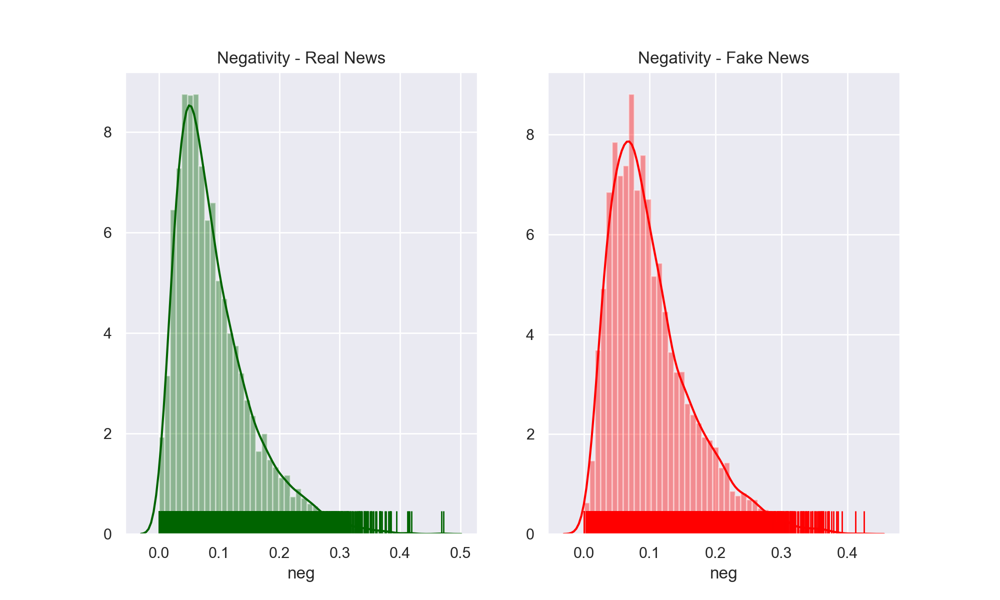

In [226]:
# real/fake nltk sentiment (vader)
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['neg'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("Negativity - Real News")
sns.distplot(fnid[fnid['label_fnn']=='fake']['neg'],
             ax = ax[1], color = "red", rug = True).set_title("Negativity - Fake News");

In [24]:
# simple sentiment analysis - textblob
fnid['polarity'] = fnid['clean_text2'].apply(lambda x:TextBlob(x).sentiment.polarity)
fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,num_words,source2,num_chars,clean_text,clean_text2,polarity
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,900,blogs.tampabay.com,5222,gov charlie crist launched what amounts to a n...,gov charlie crist launched amounts nuclear att...,0.021587
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,752,www.bobbyscott.house.gov,4351,us rep bobby scott d3rd was not pleased with t...,rep bobby scott d3rd pleased debt limit deal l...,0.010920
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,540,www.wispolitics.com,3336,amid reports questioning foxconn technology gr...,amid reports questioning foxconn technology gr...,0.123333
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,397,www.davearonberg.com,2366,state sen dave aronberg a democratic candidate...,state sen dave aronberg democratic candidate a...,0.363294
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,615,www.mystatesman.com,3762,from the citrus of the rio grande valley to th...,citrus rio grande valley peaches texas hill co...,0.048551


In [25]:
# real news polarity stats
fnid[fnid['label_fnn']=='real']['polarity'].describe()

count    8767.000000
mean        0.059819
std         0.070434
min        -0.379365
25%         0.019887
50%         0.060883
75%         0.101497
max         0.411905
Name: polarity, dtype: float64

In [26]:
# fake news polarity stats
fnid[fnid['label_fnn']=='fake']['polarity'].describe()

count    8557.000000
mean        0.038784
std         0.076695
min        -0.488889
25%        -0.002885
50%         0.041769
75%         0.084392
max         0.475000
Name: polarity, dtype: float64

<IPython.core.display.Javascript object>


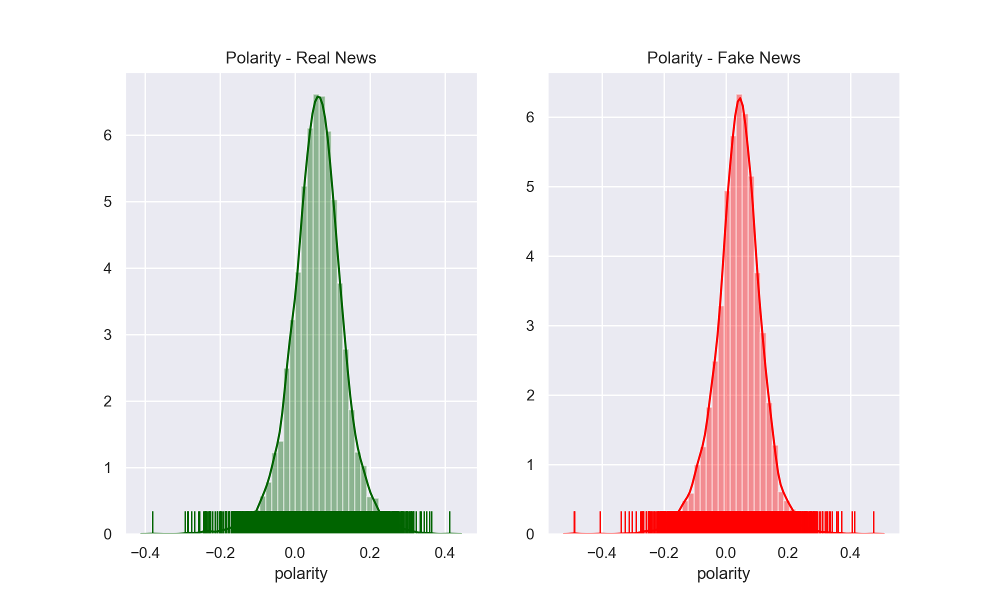

In [27]:
# polarity fake/real
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['polarity'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("Polarity - Real News")
sns.distplot(fnid[fnid['label_fnn']=='fake']['polarity'],
             ax = ax[1], color = "red", rug = True).set_title("Polarity - Fake News");

In [40]:
# export dataframe - so reload next time
fnid.to_csv('fnid_with_sentiment2.csv') 

# fnid = pd.read_csv('fnid_with_sentiment2.csv')

In [34]:
# text2emotion - test
te.get_emotion(fnid['clean_text2'][0])

{'Happy': 0.09, 'Angry': 0.01, 'Surprise': 0.28, 'Sad': 0.3, 'Fear': 0.32}

In [166]:
# text2emotion - full dataframe - takes a long time - do in multiple runs
emotions = []
i = 0
#for a in fnid['clean_text2']:
# calc rest of emotion rows (10057)
for a in fnid['clean_text2'][7267:]:
    e = te.get_emotion(a)
    emotions.append(e)   

In [45]:
len(fnid['clean_text2'][:7267])

7267

In [46]:
# save first 7267 rows
with open("emotions.txt", "wb") as fp:   
    pickle.dump(emotions, fp) 

In [168]:
# get first 7267 rows
with open("emotions.txt", "rb") as fp:   
    emotions1 = pickle.load(fp)

In [170]:
fnid.shape

(17324, 20)

In [169]:
len(emotions1)

7267

In [167]:
len(emotions)

10057

In [171]:
# join first 2 calculations
emotions_full = emotions1 + emotions
len(emotions_full)

17324

In [172]:
# save full emotion
with open("emotions_full.txt", "wb") as fp:   
    pickle.dump(emotions_full, fp) 

In [173]:
emotions_full[:4]

[{'Happy': 0.09, 'Angry': 0.01, 'Surprise': 0.28, 'Sad': 0.3, 'Fear': 0.32},
 {'Happy': 0.04, 'Angry': 0.0, 'Surprise': 0.54, 'Sad': 0.1, 'Fear': 0.32},
 {'Happy': 0.01, 'Angry': 0.09, 'Surprise': 0.21, 'Sad': 0.1, 'Fear': 0.6},
 {'Happy': 0.22, 'Angry': 0.0, 'Surprise': 0.25, 'Sad': 0.11, 'Fear': 0.42}]

In [174]:
# add dictionary to dataframe
fnid['emotions'] = emotions_full
fnid.head()

,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,...,source2,num_chars,clean_text,clean_text2,polarity,neg,neu,pos,compound,emotions
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,...,blogs.tampabay.com,5222,gov charlie crist launched what amounts to a n...,gov charlie crist launched amounts nuclear att...,0.021587,0.074,0.783,0.143,0.9862,"{'Happy': 0.09, 'Angry': 0.01, 'Surprise': 0.2..."
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,...,www.bobbyscott.house.gov,4351,us rep bobby scott d3rd was not pleased with t...,rep bobby scott d3rd pleased debt limit deal l...,0.010920,0.185,0.694,0.121,-0.9690,"{'Happy': 0.04, 'Angry': 0.0, 'Surprise': 0.54..."
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,...,www.wispolitics.com,3336,amid reports questioning foxconn technology gr...,amid reports questioning foxconn technology gr...,0.123333,0.021,0.871,0.108,0.9729,"{'Happy': 0.01, 'Angry': 0.09, 'Surprise': 0.2..."
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,...,www.davearonberg.com,2366,state sen dave aronberg a democratic candidate...,state sen dave aronberg democratic candidate a...,0.363294,0.017,0.696,0.287,0.9968,"{'Happy': 0.22, 'Angry': 0.0, 'Surprise': 0.25..."
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,...,www.mystatesman.com,3762,from the citrus of the rio grande valley to th...,citrus rio grande valley peaches texas hill co...,0.048551,0.039,0.926,0.035,-0.4019,"{'Happy': 0.04, 'Angry': 0.03, 'Surprise': 0.2..."


In [175]:
fnid.isnull().sum()

id                         0
date                       0
speaker                    0
statement                  0
sources                    0
paragraph_based_content    0
fullText_based_content     0
label_fnn                  0
date2                      0
year                       0
num_words                  0
source2                    0
num_chars                  0
clean_text                 0
clean_text2                0
polarity                   0
neg                        0
neu                        0
pos                        0
compound                   0
emotions                   0
dtype: int64

In [177]:
# split emotions into multiple columns
emotions_split = fnid['emotions'].apply(pd.Series)
print(emotions_split.shape)
emotions_split.head()

(17324, 5)


,Happy,Angry,Surprise,Sad,Fear
0,0.09,0.01,0.28,0.30,0.32
1,0.04,0.00,0.54,0.10,0.32
2,0.01,0.09,0.21,0.10,0.60
3,0.22,0.00,0.25,0.11,0.42
4,0.04,0.03,0.21,0.26,0.47


In [179]:
# join data frame with split emotion columns
fnid = pd.concat([fnid, emotions_split], axis = 1)
print(fnid.shape)
fnid.head()

(17324, 26)


,id,date,speaker,statement,sources,paragraph_based_content,fullText_based_content,label_fnn,date2,year,...,neg,neu,pos,compound,emotions,Happy,Angry,Surprise,Sad,Fear
0,1636,2010-03-28T17:45:34-04:00,Charlie Crist,"Rubio's tax swap proposal ""would have been a m...",['http://blogs.tampabay.com/buzz/files/040307l...,['Gov. Charlie Crist launched what amounts to ...,Gov. Charlie Crist launched what amounts to a ...,fake,2010-03-28,2010,...,0.074,0.783,0.143,0.9862,"{'Happy': 0.09, 'Angry': 0.01, 'Surprise': 0.2...",0.09,0.01,0.28,0.30,0.32
1,4352,2011-08-29T06:00:00-04:00,Bobby Scott,"""The estimated savings of this (debt ceiling) ...",['http://www.bobbyscott.house.gov/index.php?op...,"['U.S. Rep. Bobby Scott, D-3rd, was not please...","U.S. Rep. Bobby Scott, D-3rd, was not pleased ...",real,2011-08-29,2011,...,0.185,0.694,0.121,-0.9690,"{'Happy': 0.04, 'Angry': 0.0, 'Surprise': 0.54...",0.04,0.00,0.54,0.10,0.32
2,16471,2019-02-12T17:35:38-05:00,Wisconsin Republican Legislative leaders,"Foxconn has already ""made a positive impact ac...",['https://www.wispolitics.com/2019/sen-fitzger...,"[""Amid reports questioning Foxconn Technology ...",Amid reports questioning Foxconn Technology Gr...,fake,2019-02-12,2019,...,0.021,0.871,0.108,0.9729,"{'Happy': 0.01, 'Angry': 0.09, 'Surprise': 0.2...",0.01,0.09,0.21,0.10,0.60
3,1557,2010-03-05T18:24:02-05:00,Dave Aronberg,"Says Gov. Charlie Crist has called him ""a rock...","['http://www.davearonberg.com/about', 'http://...","[""State Sen. Dave Aronberg, a Democratic candi...","State Sen. Dave Aronberg, a Democratic candida...",real,2010-03-05,2010,...,0.017,0.696,0.287,0.9968,"{'Happy': 0.22, 'Angry': 0.0, 'Surprise': 0.25...",0.22,0.00,0.25,0.11,0.42
4,12826,2016-07-29T18:09:31-04:00,Jeannette Vaught,"""Only five Texas counties account for almost 9...",['http://www.mystatesman.com/news/news/opinion...,['From the citrus of the Rio Grande Valley to ...,From the citrus of the Rio Grande Valley to th...,fake,2016-07-29,2016,...,0.039,0.926,0.035,-0.4019,"{'Happy': 0.04, 'Angry': 0.03, 'Surprise': 0.2...",0.04,0.03,0.21,0.26,0.47


In [180]:
# export dataframe - so reload next time
fnid.to_csv('fnid_with_sentiment3.csv') 

# fnid = pd.read_csv('fnid_with_sentiment3.csv')

In [181]:
# average emotion - angry, sad, fear
print('Real average anger:', fnid[fnid['label_fnn']=='real']['Angry'].mean())
print('Fake average anger:', fnid[fnid['label_fnn']=='fake']['Angry'].mean())

print('Real average sadness:', fnid[fnid['label_fnn']=='real']['Sad'].mean())
print('Fake average sadness:', fnid[fnid['label_fnn']=='fake']['Sad'].mean())

print('Real average fear:', fnid[fnid['label_fnn']=='real']['Fear'].mean())
print('Fake average fear:', fnid[fnid['label_fnn']=='fake']['Fear'].mean())

Real average anger: 0.03368427056005475
Fake average anger: 0.036561879163258156
Real average sadness: 0.18796053382000683
Fake average sadness: 0.18630828561411714
Real average fear: 0.4477495152275579
Fake average fear: 0.4274956176229987


<IPython.core.display.Javascript object>


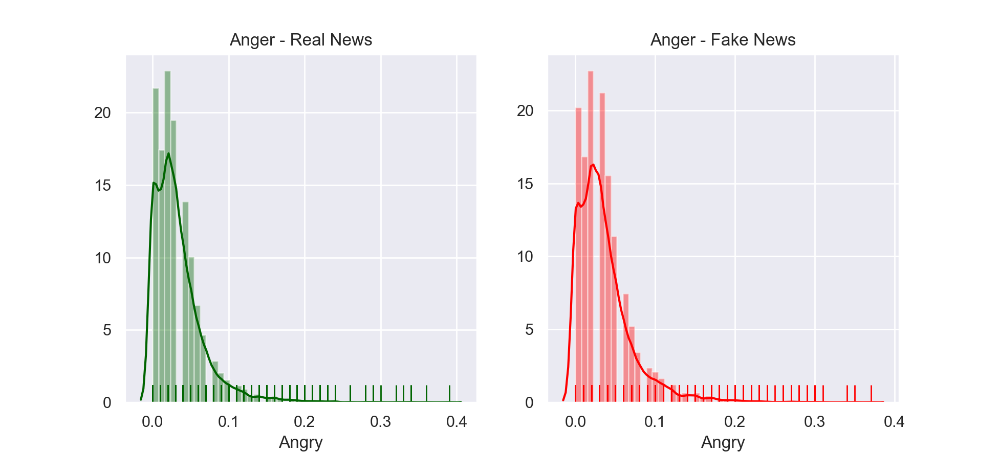

In [184]:
# emotion fake/real - angry
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['Angry'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("Anger - Real News")
sns.distplot(fnid[fnid['label_fnn']=='fake']['Angry'],
             ax = ax[1], color = "red", rug = True).set_title("Anger - Fake News");

<IPython.core.display.Javascript object>


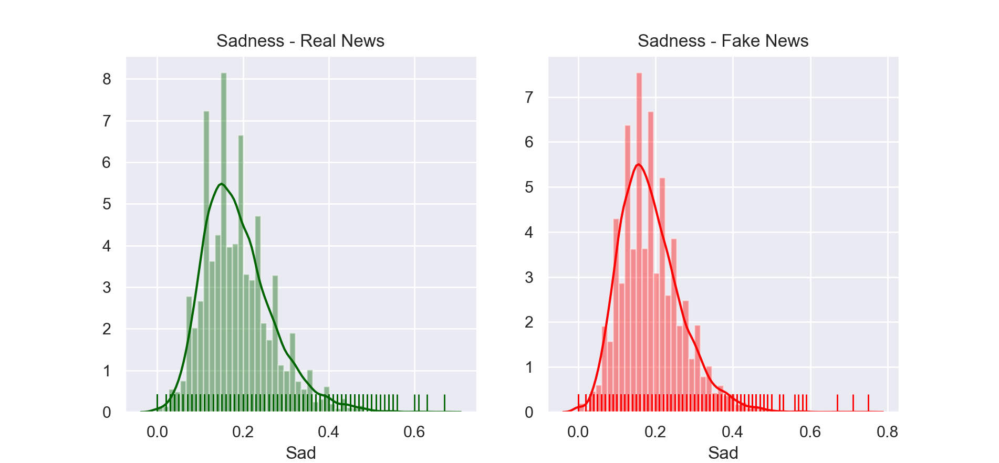

In [185]:
# emotion fake/real - sad
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['Sad'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("Sadness - Real News")
sns.distplot(fnid[fnid['label_fnn']=='fake']['Sad'],
             ax = ax[1], color = "red", rug = True).set_title("Sadness - Fake News");

<IPython.core.display.Javascript object>


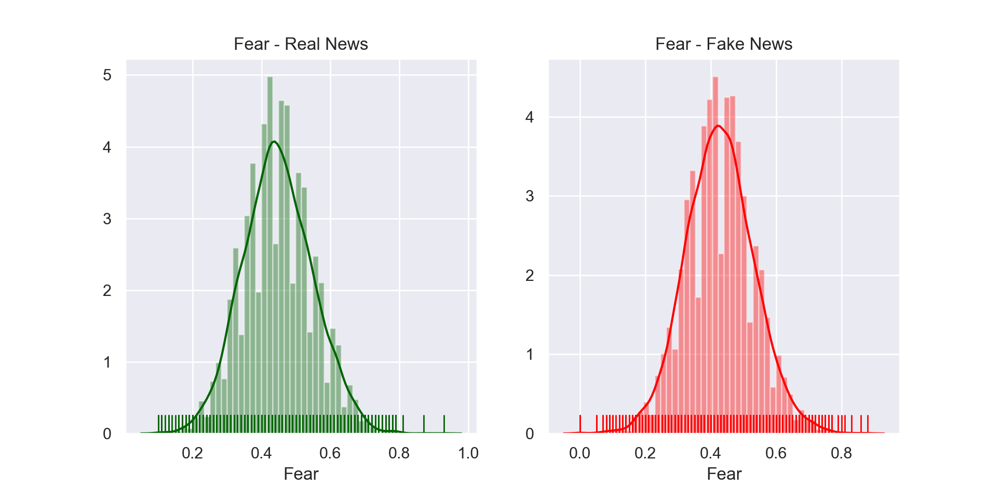

In [186]:
# emotion fake/real - fear
fig, ax = plt.subplots(1, 2, figsize=(10, 6))
sns.distplot(fnid[fnid['label_fnn']=='real']['Fear'], 
             ax = ax[0], color = "darkgreen", rug = True).set_title("Fear - Real News")
sns.distplot(fnid[fnid['label_fnn']=='fake']['Fear'],
             ax = ax[1], color = "red", rug = True).set_title("Fear - Fake News");

#### Topic Modeling
Latent Dirichlet Allocation (LDA)

In [139]:
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

In [150]:
# true data - use lemmatized/token text - 10 topics
true_token1 = [d.split() for d in true_token]
id2word_true = corpora.Dictionary(true_token1)
corpus_true = [id2word_true.doc2bow(text) for text in true_token1]

lda_model_true = gensim.models.ldamodel.LdaModel(corpus=corpus_true, id2word=id2word_true,
                                           num_topics=10, random_state=100)

In [151]:
# true topics - 10
lda_model_true.print_topics()

[(0,
  '0.179*"percent" + 0.084*"people" + 0.081*"million" + 0.044*"2010" + 0.037*"pay" + 0.031*"student" + 0.026*"check" + 0.022*"measure" + 0.020*"war" + 0.019*"washington"'),
 (1,
  '0.166*"tax" + 0.079*"new" + 0.065*"report" + 0.049*"american" + 0.027*"bush" + 0.024*"ad" + 0.023*"going" + 0.023*"2007" + 0.021*"different" + 0.021*"nearly"'),
 (2,
  '0.146*"year" + 0.097*"number" + 0.049*"house" + 0.036*"money" + 0.033*"support" + 0.032*"cost" + 0.029*"think" + 0.028*"debt" + 0.027*"company" + 0.025*"mean"'),
 (3,
  '0.257*"state" + 0.044*"care" + 0.043*"national" + 0.041*"increase" + 0.040*"figure" + 0.036*"country" + 0.032*"member" + 0.031*"total" + 0.029*"story" + 0.021*"population"'),
 (4,
  '0.070*"republican" + 0.065*"according" + 0.052*"told" + 0.047*"department" + 0.036*"issue" + 0.027*"know" + 0.027*"10" + 0.027*"fact" + 0.026*"family" + 0.025*"didnt"'),
 (5,
  '0.279*"said" + 0.062*"law" + 0.048*"office" + 0.040*"campaign" + 0.038*"public" + 0.038*"right" + 0.037*"group" + 

In [152]:
# coherence score - real news - 10 topics
coherence_model_lda_true = CoherenceModel(model=lda_model_true, texts=true_token1, dictionary=id2word_true, coherence='c_v')
coherence_lda_true = coherence_model_lda_true.get_coherence()
print('\nCoherence Score (Real News Data): ', coherence_lda_true)


Coherence Score (Real News Data):  0.8306003237596051


<IPython.core.display.Javascript object>


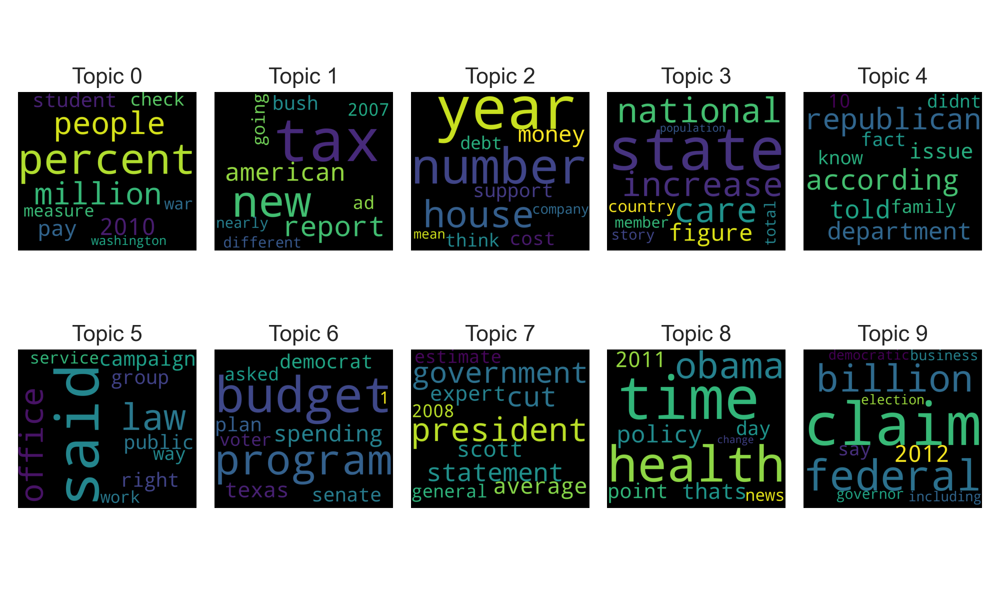

In [160]:
# visualize with word cloud - true topic model - 10 topics
fig, axes = plt.subplots(2, 5, figsize=(10, 6),sharex=True, sharey=True)
wc_real_topics = WordCloud(max_words = 20, width = 900, height = 800, stopwords = gensim_stop)
topics_true = lda_model_true.show_topics(formatted=False)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics_true[i][1])
    wc_real_topics.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(wc_real_topics)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    
fig.tight_layout();

In [161]:
# fake data - use lemmatized/token text - 10 topics
false_token1 = [d.split() for d in false_token]
id2word_false = corpora.Dictionary(false_token1)
corpus_false = [id2word_false.doc2bow(text) for text in false_token1]

lda_model_false = gensim.models.ldamodel.LdaModel(corpus=corpus_false, id2word=id2word_false,
                                           num_topics=10, random_state=100)

lda_model_false.print_topics()

[(0,
  '0.087*"percent" + 0.072*"law" + 0.054*"president" + 0.050*"campaign" + 0.046*"report" + 0.040*"according" + 0.038*"policy" + 0.036*"post" + 0.035*"plan" + 0.033*"act"'),
 (1,
  '0.115*"year" + 0.074*"trump" + 0.050*"billion" + 0.043*"country" + 0.041*"vote" + 0.040*"day" + 0.031*"rate" + 0.030*"county" + 0.029*"including" + 0.027*"committee"'),
 (2,
  '0.092*"claim" + 0.059*"say" + 0.047*"american" + 0.043*"thats" + 0.038*"pay" + 0.035*"way" + 0.034*"department" + 0.030*"fund" + 0.029*"facebook" + 0.027*"record"'),
 (3,
  '0.355*"said" + 0.046*"cut" + 0.034*"worker" + 0.025*"march" + 0.024*"spokesman" + 0.024*"medium" + 0.024*"individual" + 0.021*"bush" + 0.021*"passed" + 0.021*"true"'),
 (4,
  '0.071*"federal" + 0.060*"group" + 0.052*"office" + 0.051*"democrat" + 0.047*"senate" + 0.039*"child" + 0.033*"story" + 0.030*"spending" + 0.030*"article" + 0.029*"sen"'),
 (5,
  '0.082*"republican" + 0.075*"news" + 0.061*"house" + 0.058*"told" + 0.036*"family" + 0.036*"insurance" + 0.03


Coherence Score (Fake News Data):  0.8306462617229858


<IPython.core.display.Javascript object>


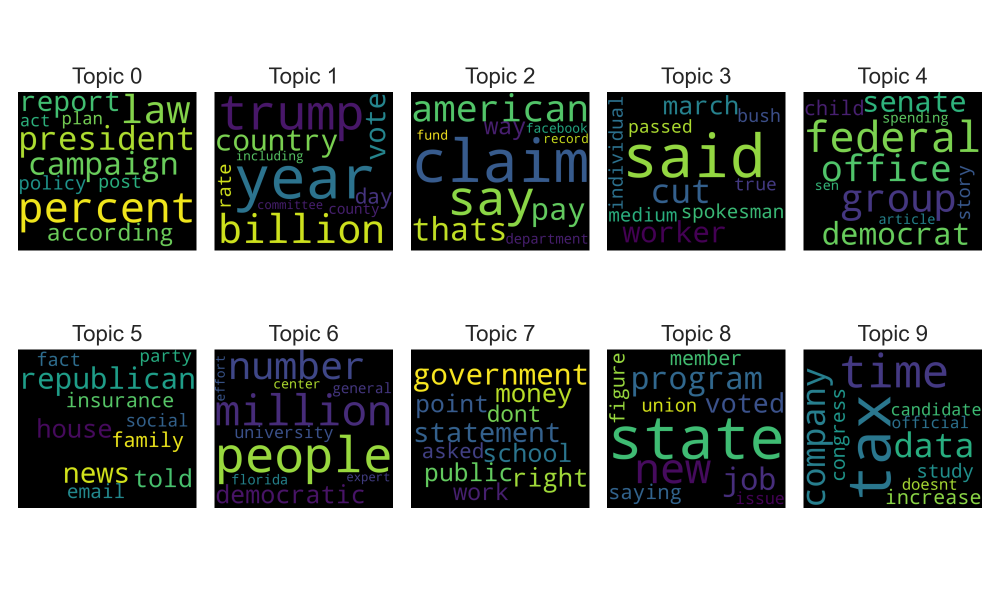

In [162]:
# fake news - coherence score and word clouds - 10 topics
coherence_model_lda_false = CoherenceModel(model=lda_model_false, texts=false_token1, dictionary=id2word_false, coherence='c_v')
coherence_lda_false = coherence_model_lda_false.get_coherence()
print('\nCoherence Score (Fake News Data): ', coherence_lda_false)

fig, axes = plt.subplots(2, 5, figsize=(10, 6),sharex=True, sharey=True)
wc_false_topics = WordCloud(max_words = 20, width = 900, height = 800, stopwords = gensim_stop)
topics_false = lda_model_false.show_topics(formatted=False)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics_false[i][1])
    wc_false_topics.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(wc_false_topics)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    
fig.tight_layout();


Coherence Score (Real News Data), 5 Topics:  0.8458731037041588


<IPython.core.display.Javascript object>


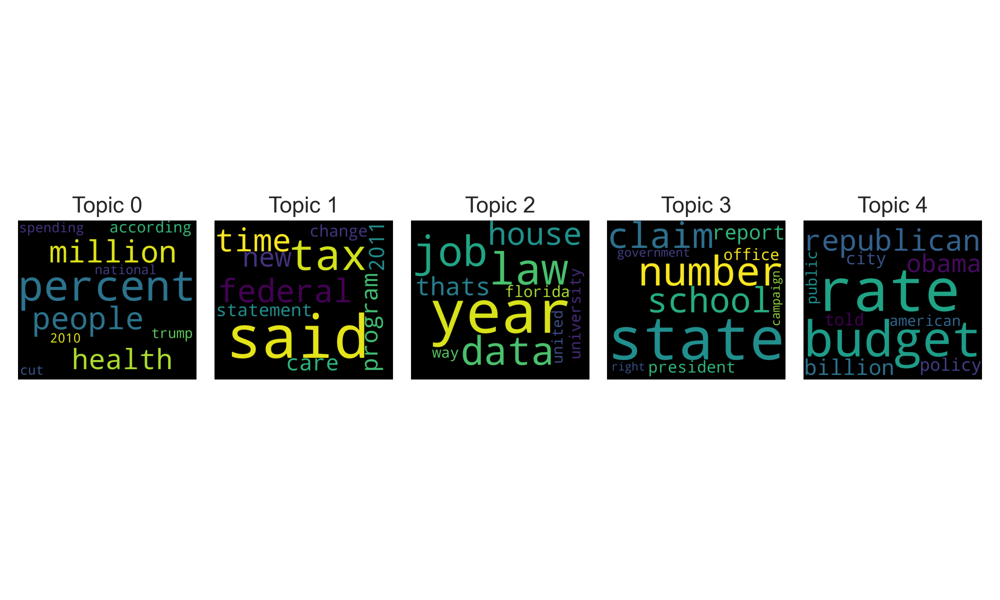

In [163]:
# true topics - 5
lda_model_true5 = gensim.models.ldamodel.LdaModel(corpus=corpus_true, id2word=id2word_true,
                                           num_topics=5, random_state=100)

coherence_model_lda_true5 = CoherenceModel(model=lda_model_true5, texts=true_token1, dictionary=id2word_true, coherence='c_v')
coherence_lda_true5 = coherence_model_lda_true5.get_coherence()
print('\nCoherence Score (Real News Data), 5 Topics: ', coherence_lda_true5)

fig, axes = plt.subplots(1, 5, figsize=(10, 6),sharex=True, sharey=True)
wc_true_topics5 = WordCloud(max_words = 20, width = 900, height = 800, stopwords = gensim_stop)
topics_true5 = lda_model_true5.show_topics(formatted=False)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics_true5[i][1])
    wc_true_topics5.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(wc_true_topics5)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    
fig.tight_layout();


Coherence Score (Fake News Data), 5 Topics:  0.8462777405630961


<IPython.core.display.Javascript object>


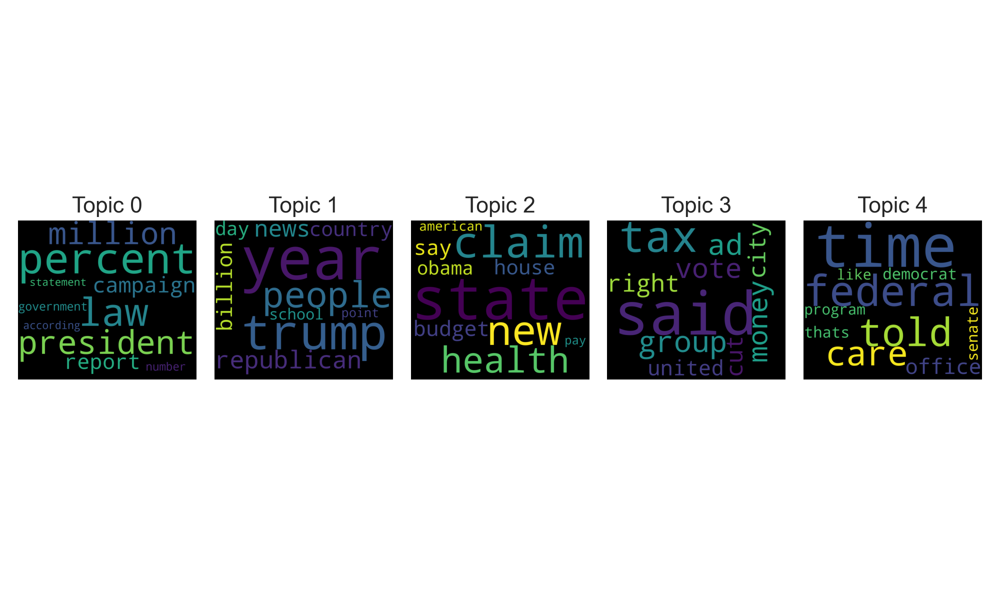

In [164]:
# fake topics - 5
lda_model_fake5 = gensim.models.ldamodel.LdaModel(corpus=corpus_false, id2word=id2word_false,
                                           num_topics=5, random_state=100)

coherence_model_lda_fake5 = CoherenceModel(model=lda_model_fake5, texts=false_token1, dictionary=id2word_false, coherence='c_v')
coherence_lda_fake5 = coherence_model_lda_fake5.get_coherence()
print('\nCoherence Score (Fake News Data), 5 Topics: ', coherence_lda_fake5)

fig, axes = plt.subplots(1, 5, figsize=(10, 6),sharex=True, sharey=True)
wc_fake_topics5 = WordCloud(max_words = 20, width = 900, height = 800, stopwords = gensim_stop)
topics_fake5 = lda_model_fake5.show_topics(formatted=False)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics_fake5[i][1])
    wc_fake_topics5.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(wc_fake_topics5)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    
fig.tight_layout();